# __Downloading the dataset__

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
! unzip /content/drive/MyDrive/CMPT732/project/dataset_1000.zip

In [ ]:
!wget 146.56.188.7/data25000.zip

--2022-11-11 17:20:09--  http://146.56.188.7/data25000.zip
Connecting to 146.56.188.7:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8532916085 (7.9G) [application/zip]
Saving to: ‘data25000.zip’

data25000.zip       100%[===================>]   7.95G  19.7MB/s    in 6m 43s  

2022-11-11 17:26:53 (20.2 MB/s) - ‘data25000.zip’ saved [8532916085/8532916085]



In [ ]:
!unzip data25000.zip

# __Importing required libraries__

In [ ]:
import os
import imageio
import numpy as np
from PIL import Image
import cv2
from skimage import io
from tqdm.auto import tqdm
from xml.etree import ElementTree
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from torchsummary import summary

# __Augmentation for face__

In [ ]:
class FaceAugmentation:
    def __init__(self,
                 image_dim,
                 brightness,    
                 contrast,
                 saturation,
                 hue,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim
        self.face_offset = face_offset
        self.crop_offset = crop_offset
        self.transform = transforms.ColorJitter(brightness, contrast, saturation, hue)
    
    def offset_crop(self, image, landmarks, crops_coordinates):
        left = round(crops_coordinates[0]) - self.face_offset
        top = round(crops_coordinates[1]) - self.face_offset
        width = round(crops_coordinates[2] - crops_coordinates[0]) + (2 * self.face_offset)
        height = round(crops_coordinates[3] - crops_coordinates[1]) + (2 * self.face_offset)

        image = TF.crop(image, top, left, height, width)
        landmarks = landmarks - np.array([[left, top]])

        new_dim = self.image_dim + self.crop_offset

        image = TF.resize(image, (new_dim, new_dim))

        landmarks[:, 0] *= new_dim / width
        landmarks[:, 1] *= new_dim / height

        return image, landmarks
    
    def random_face_crop(self, image, landmarks):
        image = np.array(image)

        h, w = image.shape[:2]

        top = np.random.randint(0, h - self.image_dim)
        left = np.random.randint(0, w - self.image_dim)

        image = image[top: top + self.image_dim, left: left + self.image_dim]

        landmarks = landmarks - np.array([[left, top]])

        return TF.to_pil_image(image), landmarks
    
    def __call__(self, image, landmarks, crops_coordinates):
        image, landmarks = self.offset_crop(image, landmarks, crops_coordinates)

        image, landmarks = self.random_face_crop(image, landmarks)

        return self.transform(image), landmarks

# __Augmentation for landmarks__

In [ ]:
class LandmarksAugmentation:
    def __init__(self, rotation_limit):
        self.rotation_limit = rotation_limit

    def random_rotation(self, image, landmarks):
        angle = np.random.uniform(-self.rotation_limit, self.rotation_limit)
        landmarks_transformation = np.array([
            [+np.cos(np.radians(angle)), -np.sin(np.radians(angle))], 
            [+np.sin(np.radians(angle)), +np.cos(np.radians(angle))]
        ])
        image = TF.rotate(image, angle)
        landmarks = landmarks - 0.5
        transformed_landmarks = np.matmul(landmarks, landmarks_transformation)
        transformed_landmarks = transformed_landmarks + 0.5

        return image, transformed_landmarks
    
    def __call__(self, image, landmarks):
        image, landmarks = self.random_rotation(image, landmarks)
        return image, landmarks

# __Data Preprocessing__

In [ ]:
class Preprocessor:
    def __init__(self,
                 image_dim,
                 brightness,
                 contrast,
                 saturation,
                 hue,
                 angle,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim

        self.landmarks_augmentation = LandmarksAugmentation(angle)
        self.face_augmentation = FaceAugmentation(image_dim, brightness, contrast, saturation, hue, face_offset, crop_offset)
    
    def __call__(self, image, landmarks, crops_coordinates):
        image = TF.to_pil_image(image)

        image, landmarks = self.face_augmentation(image, landmarks, crops_coordinates)

        landmarks = landmarks / np.array([*image.size])

        image, landmarks = self.landmarks_augmentation(image, landmarks)

        image = TF.to_grayscale(image)

        image = TF.to_tensor(image)

        image = (image - image.min())/(image.max() - image.min())
        image = (2 * image) - 1

        return image, torch.FloatTensor(landmarks.reshape(-1) - 0.5)

# __Creating the dataset class__

In [ ]:
from matplotlib.lines import Bbox

class LandmarksDataset(Dataset):
    def __init__(self, preprocessor, train):
        #self.root_dir = '/content'
        self.root_dir = '/content/dataset_10000/trainset'
        self.image_paths = []
        self.landmarks = []
        self.crops = []
        self.preprocessor = preprocessor
        self.train = train
        
        files = sorted(os.listdir(self.root_dir))
        img_list = [x for x in files if '.png' in x and 'seg' not in x]
        ldmk_list = [x for x in files if '.txt' in x]
        print('imgs:', len(img_list))
        print('ldmk:', len(ldmk_list))

        for img in img_list:
          self.image_paths.append(os.path.join(self.root_dir, img))
        
        for ldmk in ldmk_list:
          landmark = []
          # with open(os.path.join(ldmk)) as l_m:
          with open(os.path.join(self.root_dir, ldmk)) as l_m:
            labels = l_m.readlines()[:71]
            for _one_p in labels:
                xy = _one_p.rstrip().split(' ')
                landmark.append([float(xy[0]), float(xy[1])])

          rs_landmrk = np.array(landmark).reshape((-1, 2))
          bbox = [float(np.min(rs_landmrk[:, 0])), float(np.min(rs_landmrk[:, 1])), float(np.max(rs_landmrk[:, 0])), float(np.max(rs_landmrk[:, 1]))]

          self.landmarks.append(landmark)
          self.crops.append(bbox)

        self.landmarks = np.array(self.landmarks).astype('float32')
        assert len(self.image_paths) == len(self.landmarks)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        image = io.imread(self.image_paths[index], as_gray = False)
        landmarks = self.landmarks[index]
        
        image, landmarks = self.preprocessor(image, landmarks, self.crops[index])

        return image, landmarks

# __Some helper functions for visualizing the data__

In [ ]:
def visualize_image(image, landmarks):
    plt.figure(figsize = (5, 5))
    image = (image - image.min())/(image.max() - image.min())

    landmarks = landmarks.view(-1, 2)
    landmarks = (landmarks + 0.5) * preprocessor.image_dim

    plt.imshow(image[0], cmap = 'gray')
    plt.scatter(landmarks[:, 0], landmarks[:, 1], s = 25, c = 'dodgerblue')
    plt.axis('off')
    plt.show()
    
def visualize_batch(images_list, landmarks_list, size = 14, shape = (6, 6), title = None, save = None):
    fig = plt.figure(figsize = (size, size))
    grid = ImageGrid(fig, 111, nrows_ncols = shape, axes_pad = 0.08)
    for ax, image, landmarks in zip(grid, images_list, landmarks_list):
        image = (image - image.min())/(image.max() - image.min())

        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5) * preprocessor.image_dim
        landmarks = landmarks.numpy().tolist()
        landmarks = np.array([(x, y) for (x, y) in landmarks if 0 <= x <= preprocessor.image_dim and 0 <= y <= preprocessor.image_dim])

        ax.imshow(image[0], cmap = 'gray')
        ax.scatter(landmarks[:, 0], landmarks[:, 1], s = 10, c = 'dodgerblue')
        ax.axis('off')

    if title:
        print(title)
    if save:
        plt.savefig(save)
    plt.show()

# __Initializing preprocessor, train and test images__

In [ ]:
preprocessor = Preprocessor(image_dim = 128,brightness = 0.24,saturation = 0.3,contrast = 0.15,hue = 0.14,angle = 14,face_offset = 32,crop_offset = 16)

train_images = LandmarksDataset(preprocessor, train = True)
#test_images = LandmarksDataset(preprocessor, train = False)


imgs: 25568
ldmk: 25568


# __Visualizing a sample image, with random augmentations__

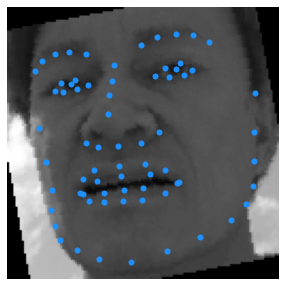

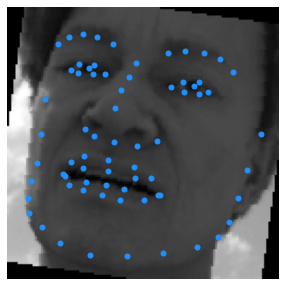

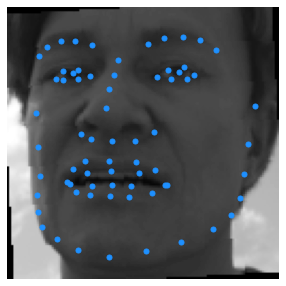

In [ ]:
image1, landmarks1 = train_images[25]
visualize_image(image1, landmarks1)

image2, landmarks2 = train_images[25]
visualize_image(image2, landmarks2)

image3, landmarks3 = train_images[25]
visualize_image(image3, landmarks3)

In [ ]:
whole_set = int(0.4 * len(train_images))
other_set = len(train_images) - whole_set
train_images, others = random_split(train_images, [whole_set, other_set])

len_val_set = int(0.1 * whole_set)
len_test_set = int(0.1 * whole_set)

len_val_set = int(0.1 * len(train_images))
# len_test_set = int(0.1 * len(train_images))

# len_train_set = len(train_images) - len_test_set
# train_images, test_images = random_split(train_images, [len_train_set, len_test_set])

len_train_set = len(train_images) - len_val_set
train_images, val_images = random_split(train_images, [len_train_set, len_val_set])

batch_size = 32
train_data = torch.utils.data.DataLoader(train_images, batch_size = batch_size, shuffle = True)
val_data = torch.utils.data.DataLoader(val_images, batch_size = 2 * batch_size, shuffle = False)
#test_data = torch.utils.data.DataLoader(test_images, batch_size = 2 * batch_size, shuffle = False)

print(f'{len_train_set} images for training')
print(f'{len_val_set} images for validating')
# print(f'{len_test_set} images for testing')

9205 images for training
1022 images for validating


# __Visualizing a sample batch__

In [ ]:
for x, y in train_data:
    break
print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

for x, y in val_data:
    break
print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

# for x, y in test_data:
#     break
# print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

torch.Size([32, 1, 128, 128]) torch.Size([32, 140]) tensor(1.) tensor(-1.) tensor(0.5161) tensor(-0.4969)
torch.Size([64, 1, 128, 128]) torch.Size([64, 140]) tensor(1.) tensor(-1.) tensor(0.5372) tensor(-0.5192)


Training Batch Samples


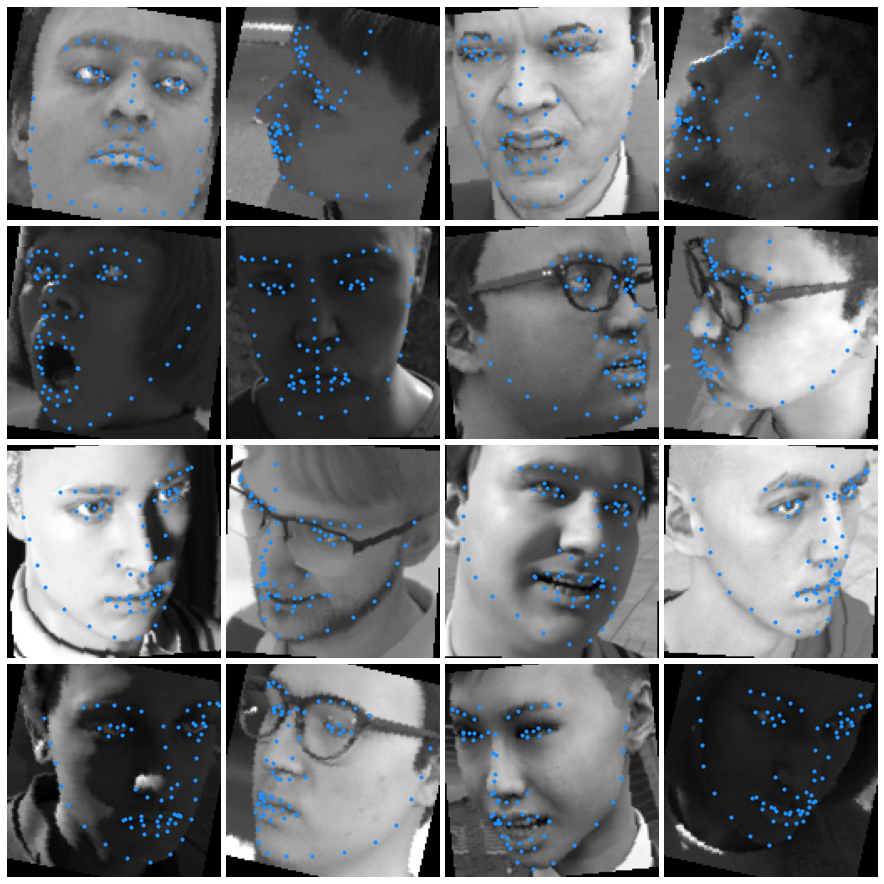

In [ ]:
visualize_batch(x[:16], y[:16], shape = (4, 4), size = 16, title = 'Training Batch Samples')

# __Creating Xception Net model architecture__

In [ ]:
class DepthewiseSeperableConv2d(nn.Module):
    def __init__(self, input_channels, output_channels, kernel_size, **kwargs):
        super(DepthewiseSeperableConv2d, self).__init__()

        self.depthwise = nn.Conv2d(input_channels, input_channels, kernel_size, groups = input_channels, bias = False, **kwargs)
        self.pointwise = nn.Conv2d(input_channels, output_channels, 1, bias = False)

    def forward(self, x):
        x = self.depthwise(x)
        x = self.pointwise(x)

        return x

In [ ]:
class EntryBlock(nn.Module):
    def __init__(self):
        super(EntryBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(1, 32, 3, padding = 1, bias = False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2)
        )

        self.conv2 = nn.Sequential(
            nn.Conv2d(32, 64, 3, padding = 1, bias = False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2)
        )

        self.conv3_residual = nn.Sequential(
            DepthewiseSeperableConv2d(64, 64, 3, padding = 1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(64, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(3, stride = 2, padding = 1),
        )

        self.conv3_direct = nn.Sequential(
            nn.Conv2d(64, 128, 1, stride = 2),
            nn.BatchNorm2d(128),
        )

        self.conv4_residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.conv4_direct = nn.Sequential(
            nn.Conv2d(128, 256, 1, stride = 2),
            nn.BatchNorm2d(256),
        )

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)

        residual = self.conv3_residual(x)
        direct = self.conv3_direct(x)
        x = residual + direct
        
        residual = self.conv4_residual(x)
        direct = self.conv4_direct(x)
        x = residual + direct

        return x

In [ ]:
class MiddleBasicBlock(nn.Module):
    def __init__(self):
        super(MiddleBasicBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv2 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv3 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.conv2(residual)
        residual = self.conv3(residual)

        return x + residual


class MiddleBlock(nn.Module):
    def __init__(self, num_blocks):
        super().__init__()

        self.block = nn.Sequential(*[MiddleBasicBlock() for _ in range(num_blocks)])

    def forward(self, x):
        x = self.block(x)

        return x

In [ ]:
class ExitBlock(nn.Module):
    def __init__(self):
        super(ExitBlock, self).__init__()

        self.residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.direct = nn.Sequential(
            nn.Conv2d(256, 512, 1, stride = 2),
            nn.BatchNorm2d(512)
        )

        self.conv = nn.Sequential(
            DepthewiseSeperableConv2d(512, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(512, 1024, 3, padding = 1),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2)
        )

        self.dropout = nn.Dropout(0.3)

        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))

    def forward(self, x):
        direct = self.direct(x)
        residual = self.residual(x)
        x = direct + residual
        
        x = self.conv(x)
        x = self.avgpool(x)
        x = self.dropout(x)

        return x

# __Initializing the Xception Net model__

In [ ]:
class XceptionNet(nn.Module):
    def __init__(self, num_middle_blocks = 6):
        super(XceptionNet, self).__init__()

        self.entry_block = EntryBlock()
        self.middel_block = MiddleBlock(num_middle_blocks)
        self.exit_block = ExitBlock()

        self.fc = nn.Linear(1024, 140)

    def forward(self, x):
        x = self.entry_block(x)
        x = self.middel_block(x)
        x = self.exit_block(x)

        x = x.view(x.size(0), -1)
        
        x = self.fc(x)

        return x

In [ ]:
model = XceptionNet()
model.cuda()

XceptionNet(
  (entry_block): EntryBlock(
    (conv1): Sequential(
      (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (conv2): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (conv3_residual): Sequential(
      (0): DepthewiseSeperableConv2d(
        (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64, bias=False)
        (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      )
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
      (3): DepthewiseSeperableConv2d(
        (dep

In [ ]:
summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]             288
       BatchNorm2d-2         [-1, 32, 128, 128]              64
         LeakyReLU-3         [-1, 32, 128, 128]               0
            Conv2d-4         [-1, 64, 128, 128]          18,432
       BatchNorm2d-5         [-1, 64, 128, 128]             128
         LeakyReLU-6         [-1, 64, 128, 128]               0
            Conv2d-7         [-1, 64, 128, 128]             576
            Conv2d-8         [-1, 64, 128, 128]           4,096
DepthewiseSeperableConv2d-9         [-1, 64, 128, 128]               0
      BatchNorm2d-10         [-1, 64, 128, 128]             128
        LeakyReLU-11         [-1, 64, 128, 128]               0
           Conv2d-12         [-1, 64, 128, 128]             576
           Conv2d-13        [-1, 128, 128, 128]           8,192
DepthewiseSeperableConv2d-14    

#ResNet-50

In [ ]:
model = torchvision.models.resnet50(weights=False, num_classes=140)

first_layer = model.conv1
weight = first_layer.weight.clone()
first_layer = torch.nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3,3), bias=False)
with torch.no_grad():
  first_layer.weight[:, :] = weight[:, :1]
model.conv1 = first_layer

model.cuda()

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           3,136
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 32, 32]               0
            Conv2d-5           [-1, 64, 32, 32]           4,096
       BatchNorm2d-6           [-1, 64, 32, 32]             128
              ReLU-7           [-1, 64, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          36,864
       BatchNorm2d-9           [-1, 64, 32, 32]             128
             ReLU-10           [-1, 64, 32, 32]               0
           Conv2d-11          [-1, 256, 32, 32]          16,384
      BatchNorm2d-12          [-1, 256, 32, 32]             512
           Conv2d-13          [-1, 256, 32, 32]          16,384
      BatchNorm2d-14          [-1, 256,

# __Initializing the objective loss and optimizer__

In [ ]:
objective = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr = 0.0008)

# __Defining validation function__

Validating:   0%|                                                                                             …

Validation sample predictions


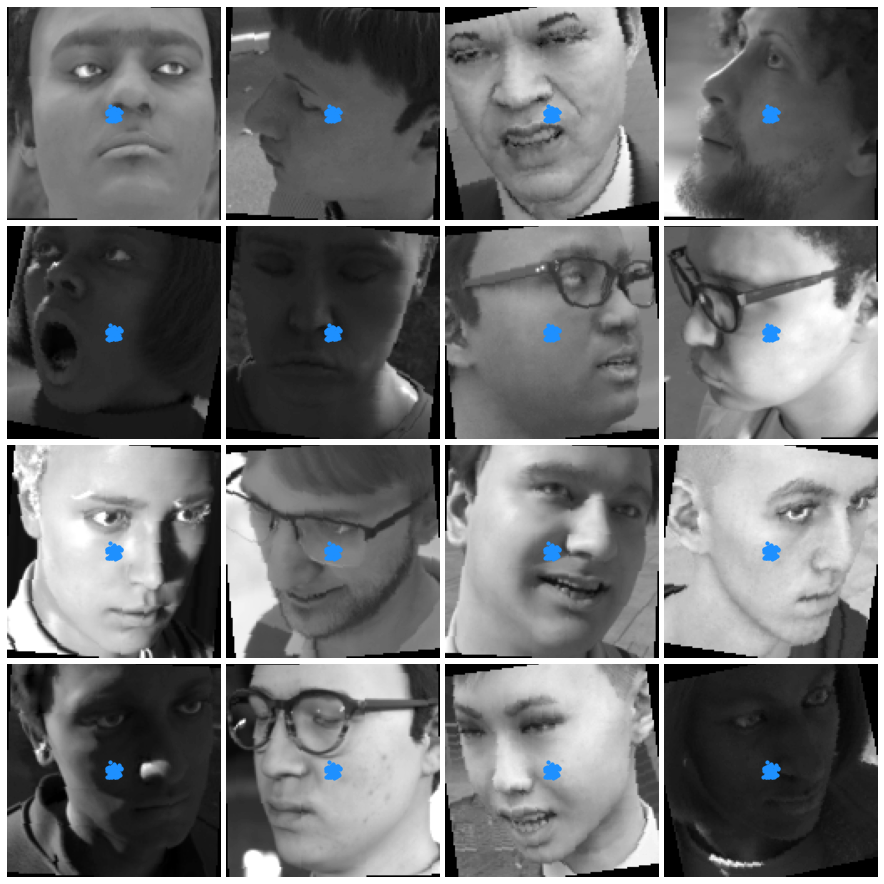

0.00365093513391912

In [ ]:
@torch.no_grad()
def validate(save = None):
    cum_loss = 0.0

    model.eval()

    for features, labels in tqdm(val_data, desc = 'Validating', ncols = 600):
        features = features.cuda()
        labels = labels.cuda()

        outputs = model(features)
        #print(outputs.shape)
        #print(labels.shape)

        loss = objective(outputs, labels)

        cum_loss += loss.item()

        break
        
    visualize_batch(features[:16].cpu(), outputs[:16].cpu(), shape = (4, 4), size = 16, title = 'Validation sample predictions', save = save)

    return cum_loss/len(val_data)

validate()

# Creating directory for storing the model's progress

In [ ]:
if os.path.isdir('progress'):
    !rm -rf progress
os.mkdir('progress')

# __And finally training the model__

Epoch(1/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


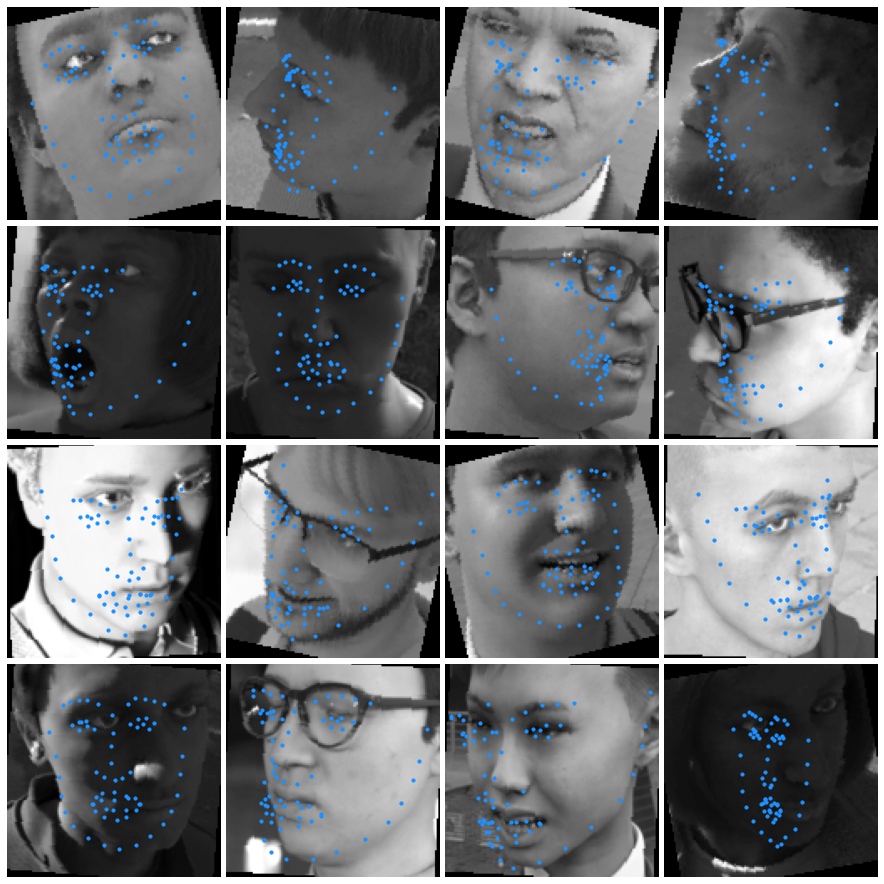

Saving model....................
Epoch(1/30) -> Training Loss: 0.01264153 | Validation Loss: 0.00042981


Epoch(2/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


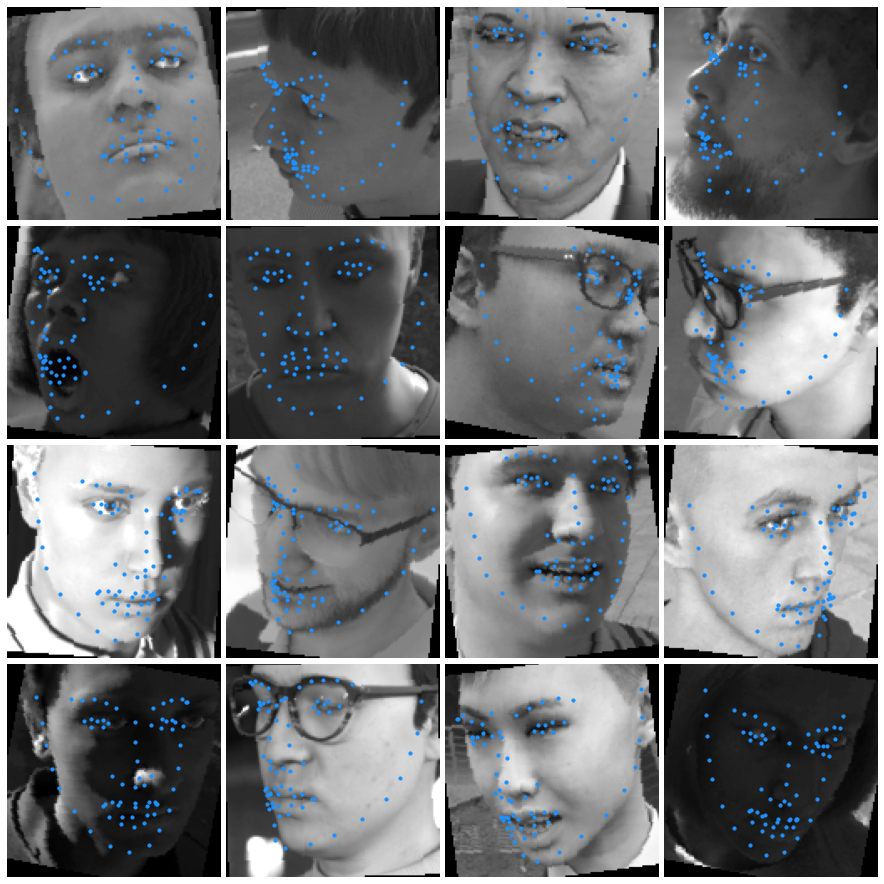

Saving model....................
Epoch(2/30) -> Training Loss: 0.00474727 | Validation Loss: 0.00013992


Epoch(3/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


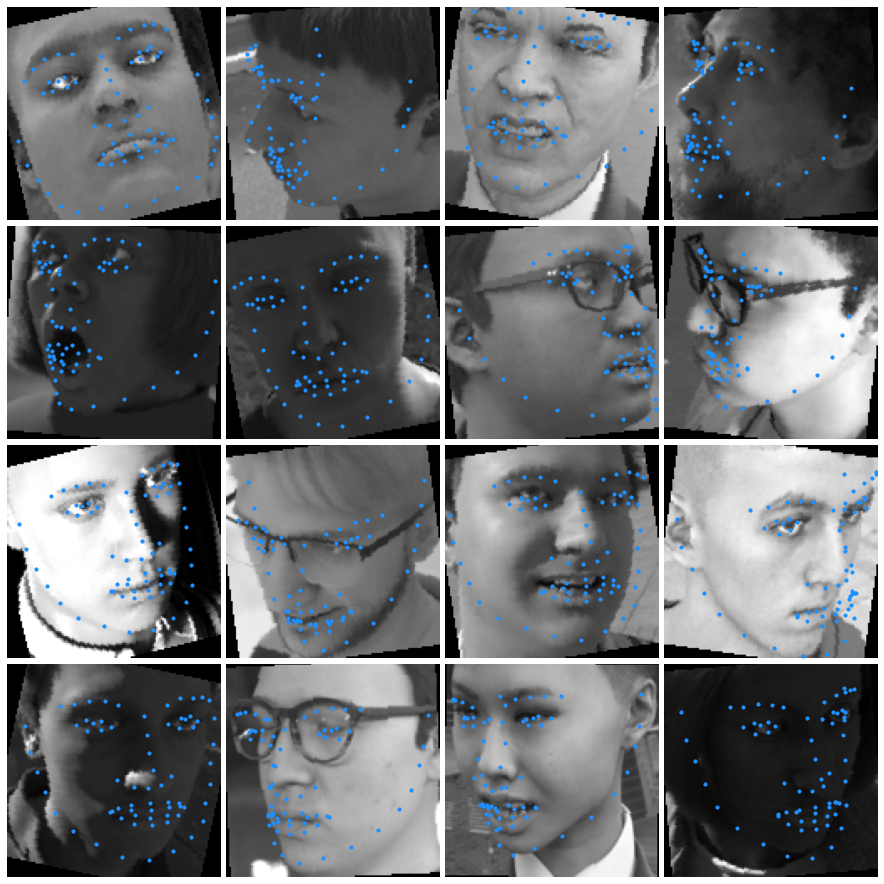

Saving model....................
Epoch(3/30) -> Training Loss: 0.00401977 | Validation Loss: 0.00013478


Epoch(4/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


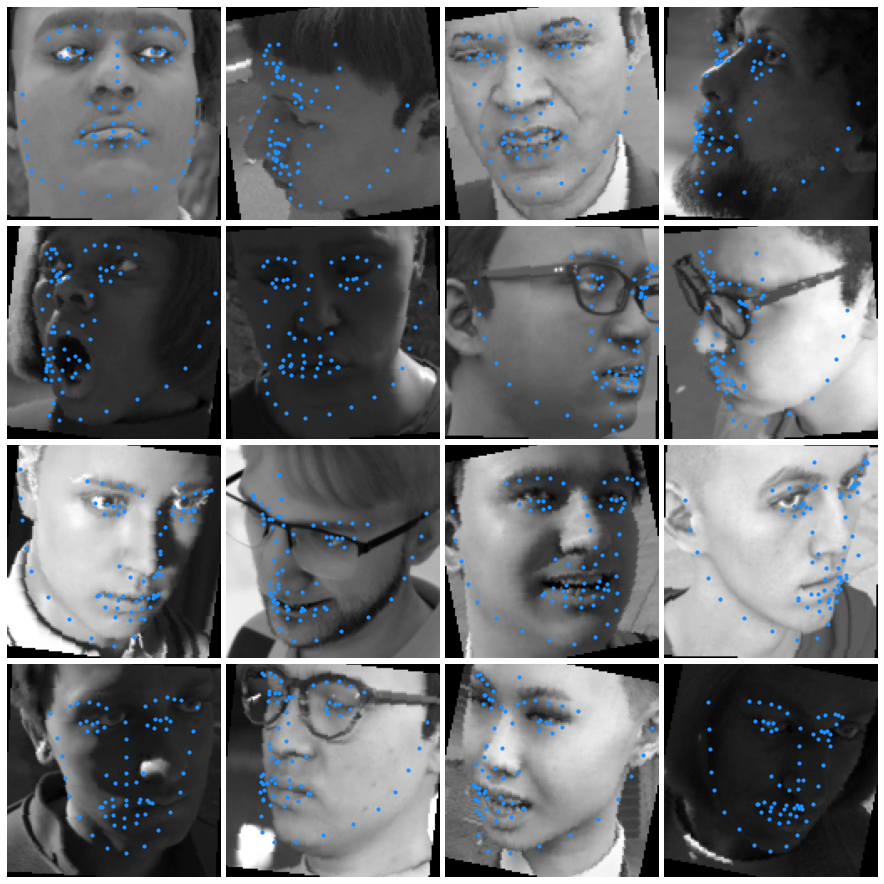

Saving model....................
Epoch(4/30) -> Training Loss: 0.00267609 | Validation Loss: 0.00011502


Epoch(5/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


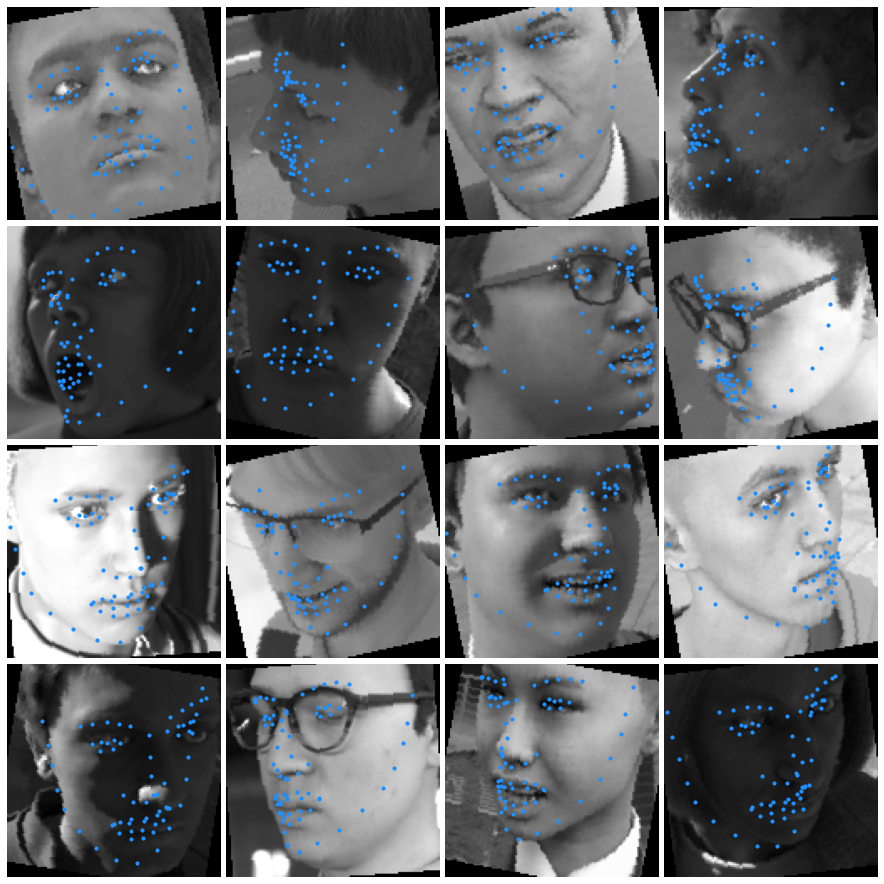

Saving model....................
Epoch(5/30) -> Training Loss: 0.00211352 | Validation Loss: 0.00010771


Epoch(6/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


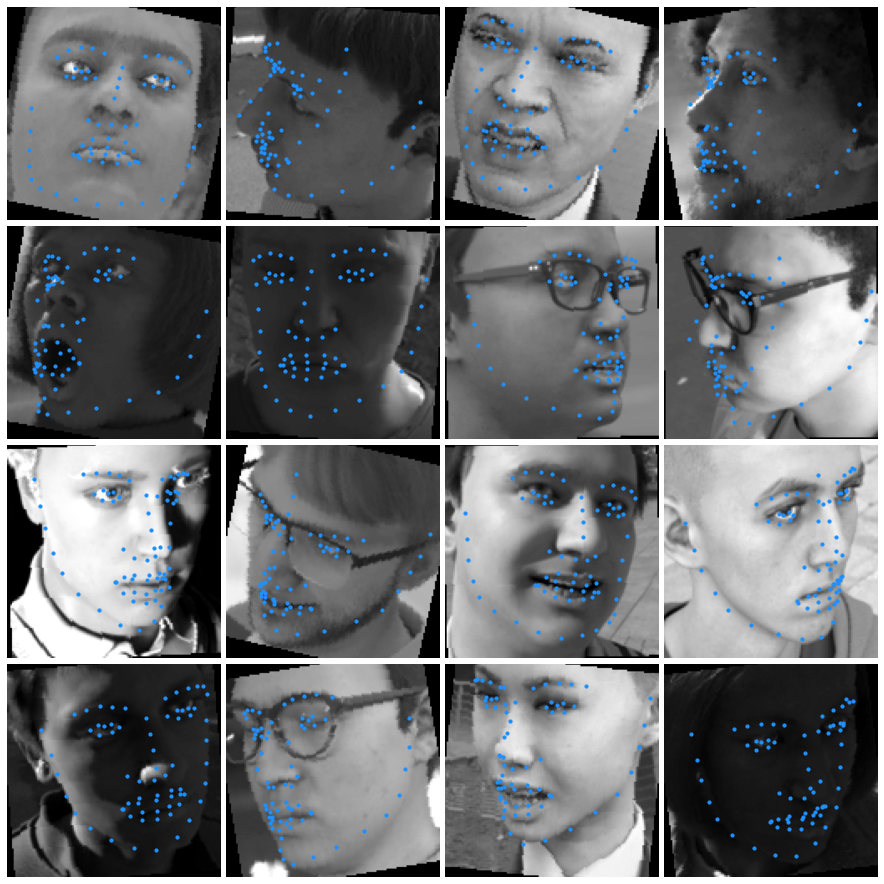

Saving model....................
Epoch(6/30) -> Training Loss: 0.00184046 | Validation Loss: 0.00009612


Epoch(7/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


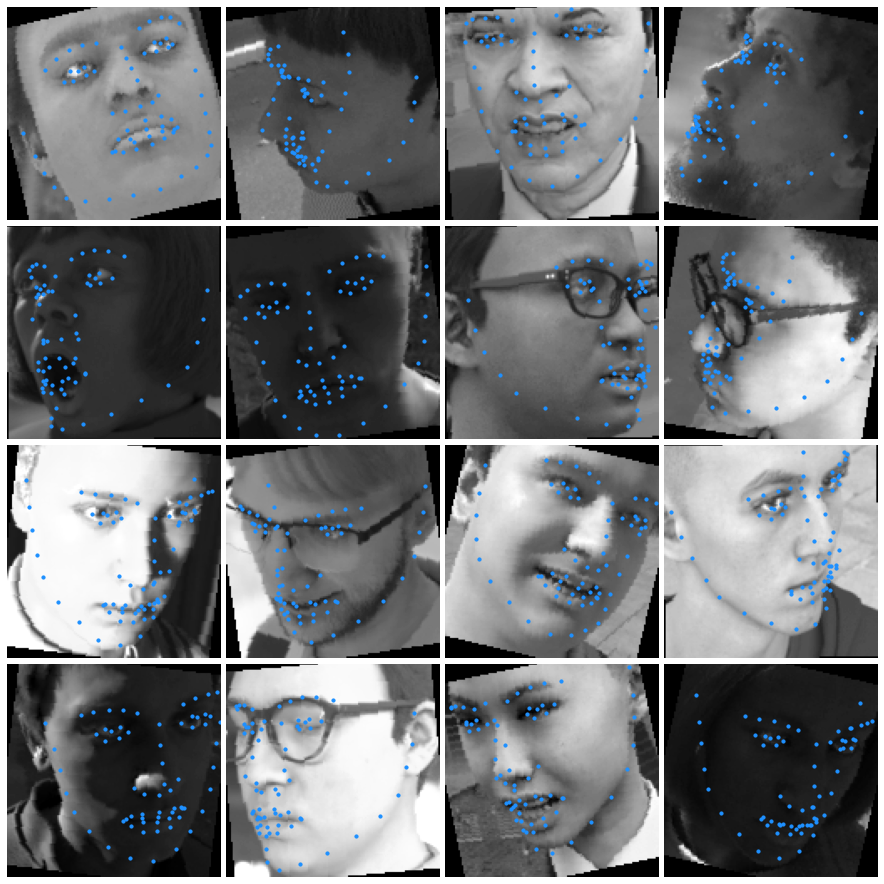

Saving model....................
Epoch(7/30) -> Training Loss: 0.00161143 | Validation Loss: 0.00006098


Epoch(8/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


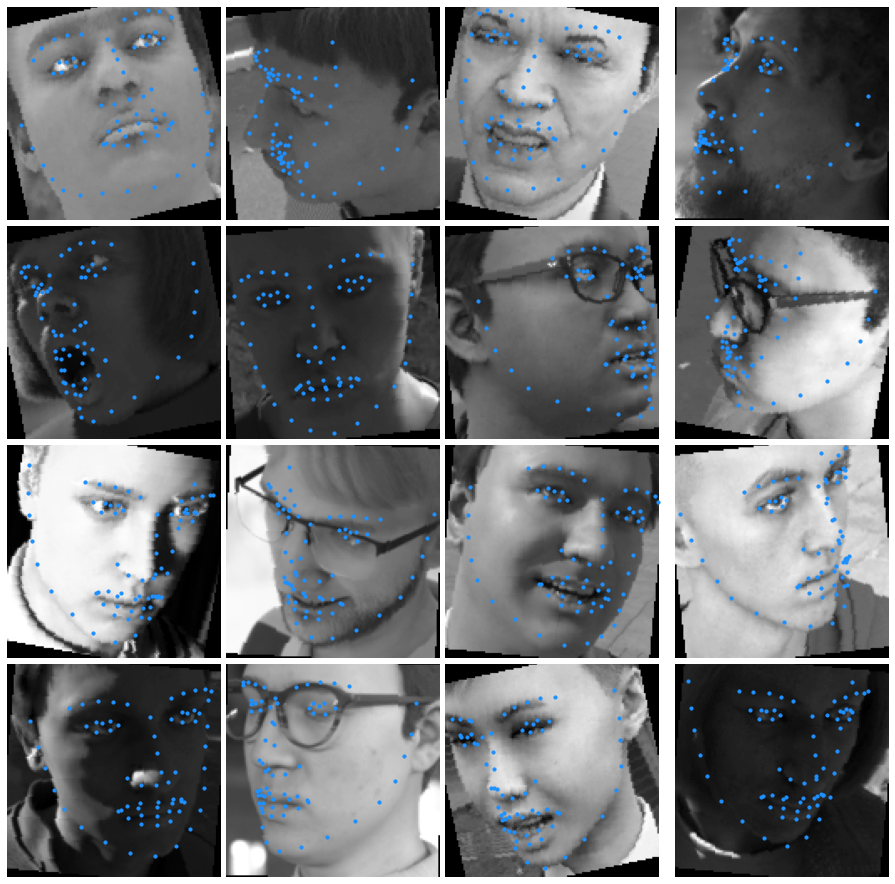

Saving model....................
Epoch(8/30) -> Training Loss: 0.00152067 | Validation Loss: 0.00005734


Epoch(9/30):   0%|                                                                                            …

Validating:   0%|                                                                                             …

Validation sample predictions


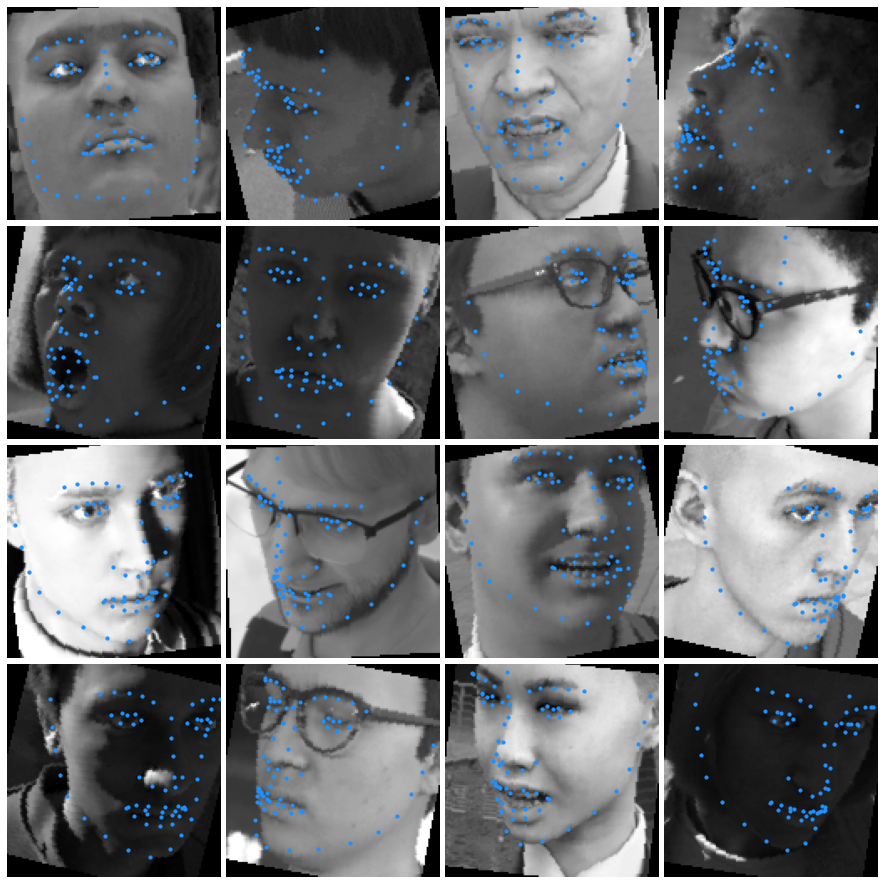

Saving model....................
Epoch(9/30) -> Training Loss: 0.00123458 | Validation Loss: 0.00004975


Epoch(10/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


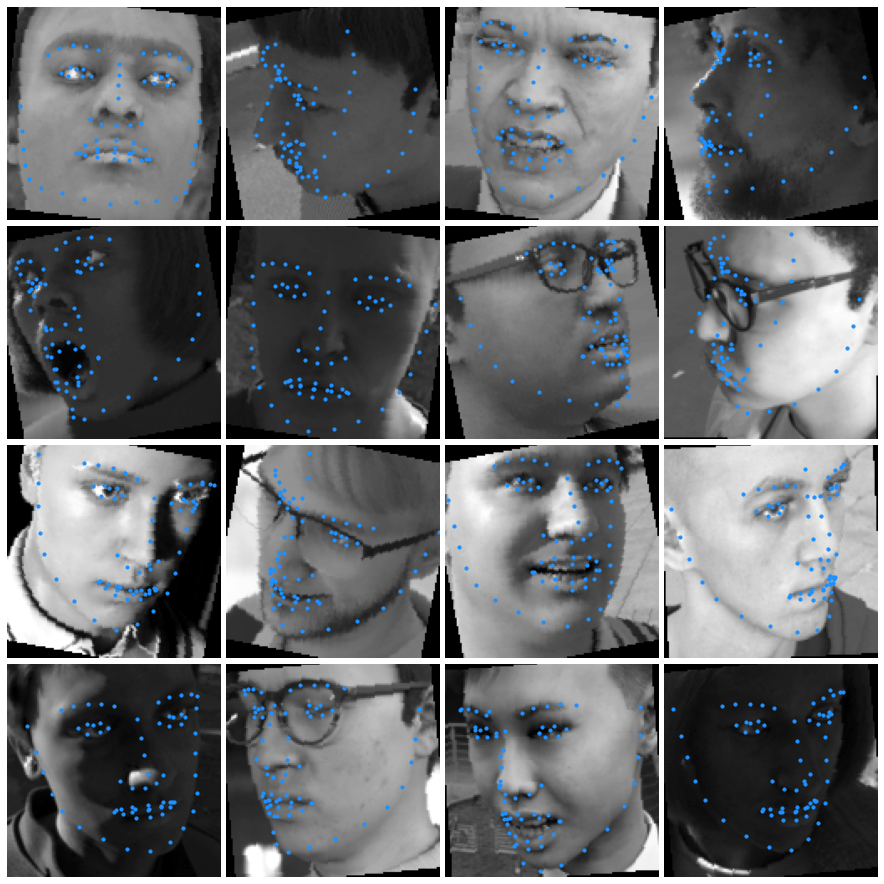

Saving model....................
Epoch(10/30) -> Training Loss: 0.00112829 | Validation Loss: 0.00004534


Epoch(11/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


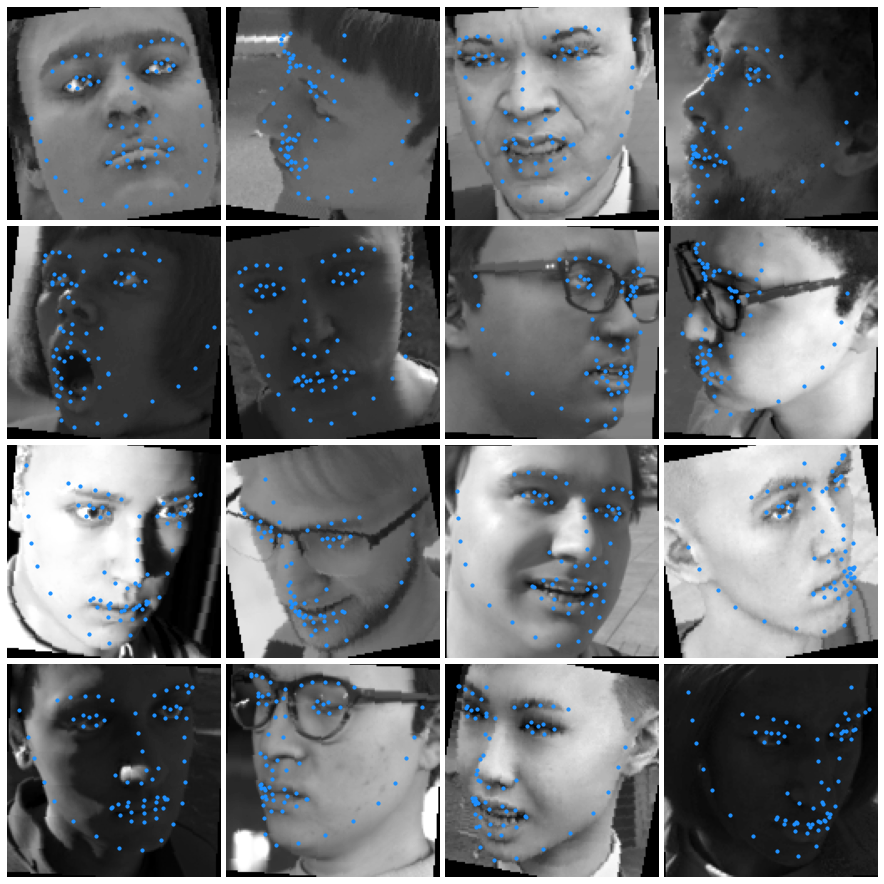

Epoch(11/30) -> Training Loss: 0.00103746 | Validation Loss: 0.00006790


Epoch(12/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


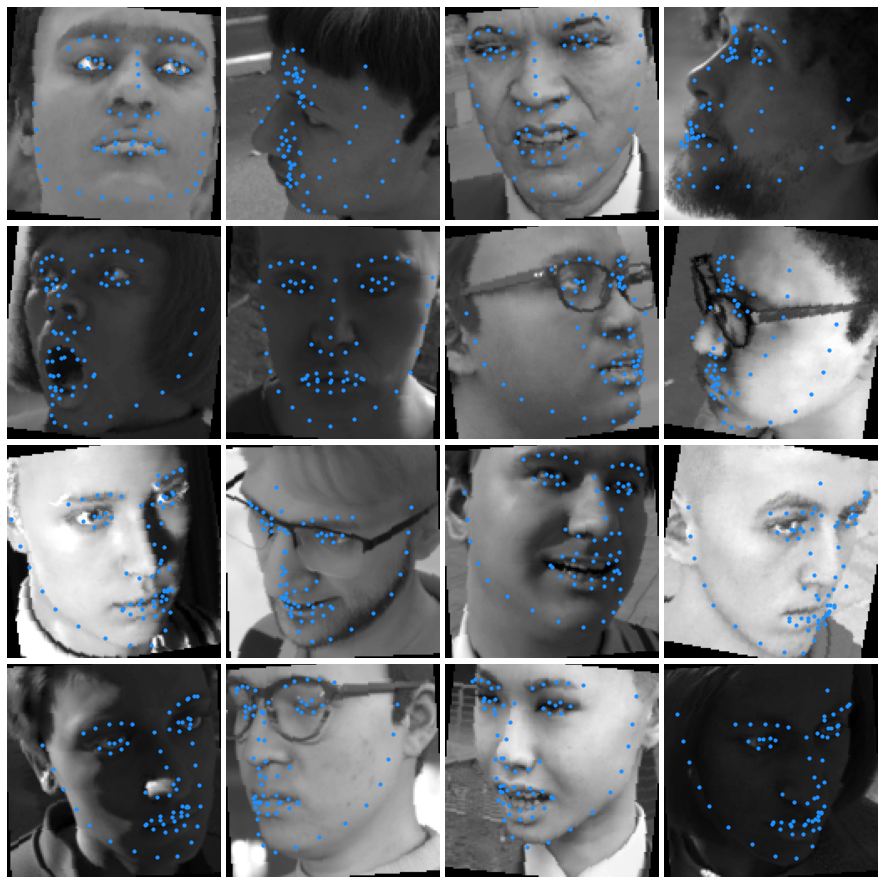

Epoch(12/30) -> Training Loss: 0.00099994 | Validation Loss: 0.00006868


Epoch(13/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


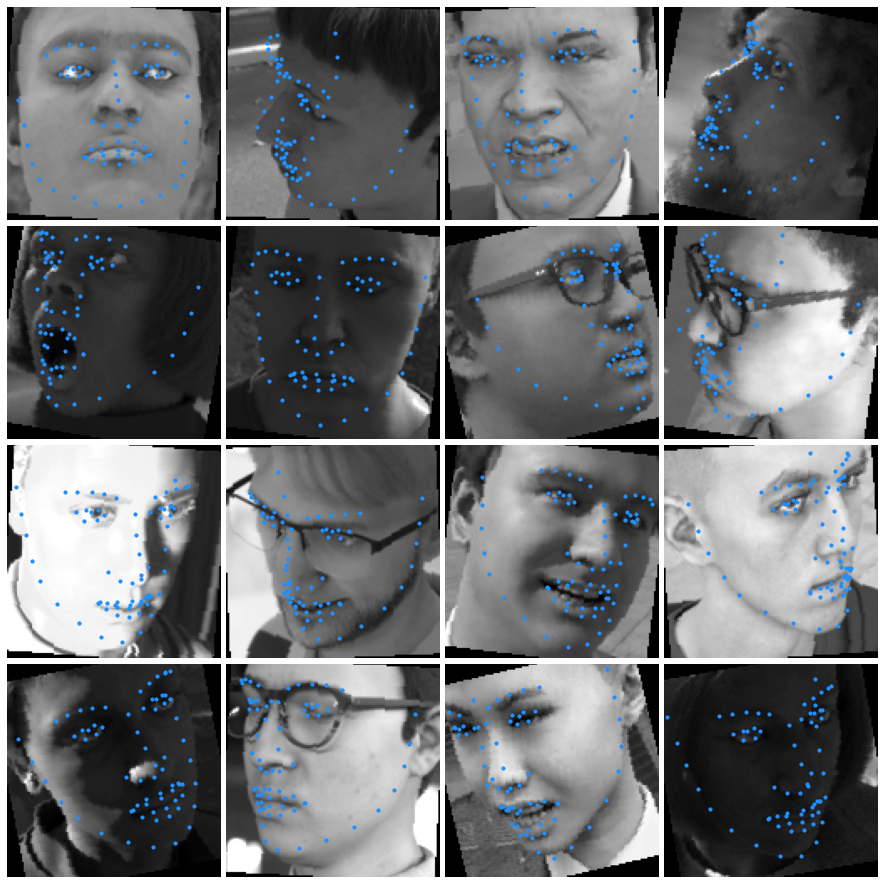

Epoch(13/30) -> Training Loss: 0.00088665 | Validation Loss: 0.00007450


Epoch(14/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


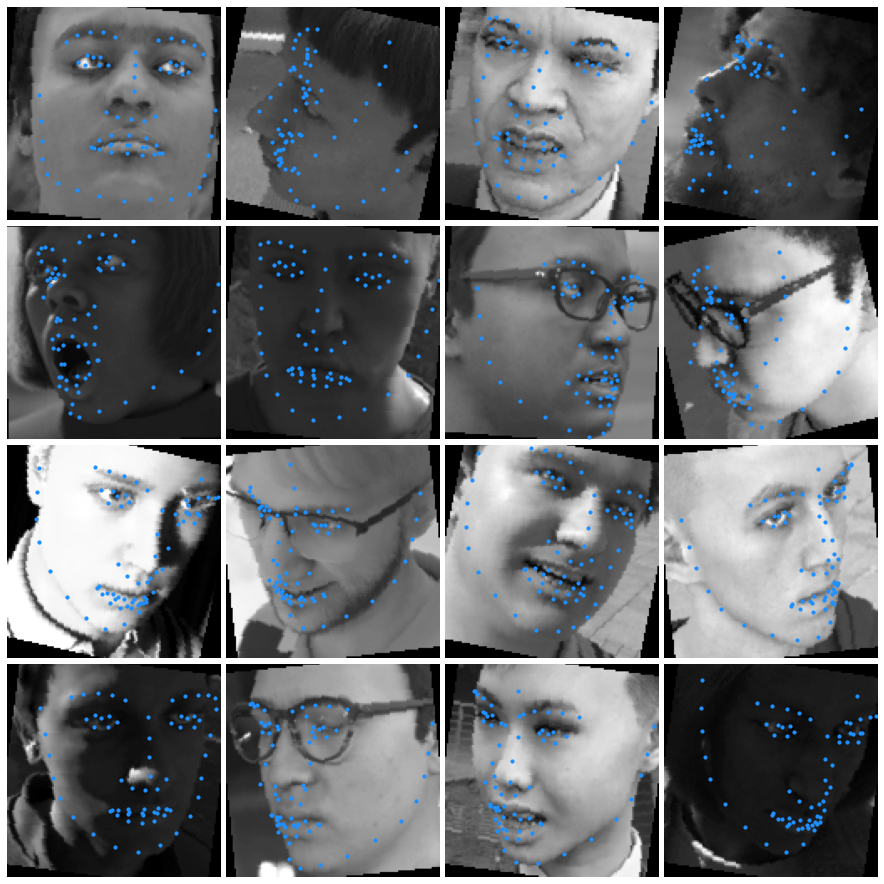

Epoch(14/30) -> Training Loss: 0.00092354 | Validation Loss: 0.00006066


Epoch(15/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


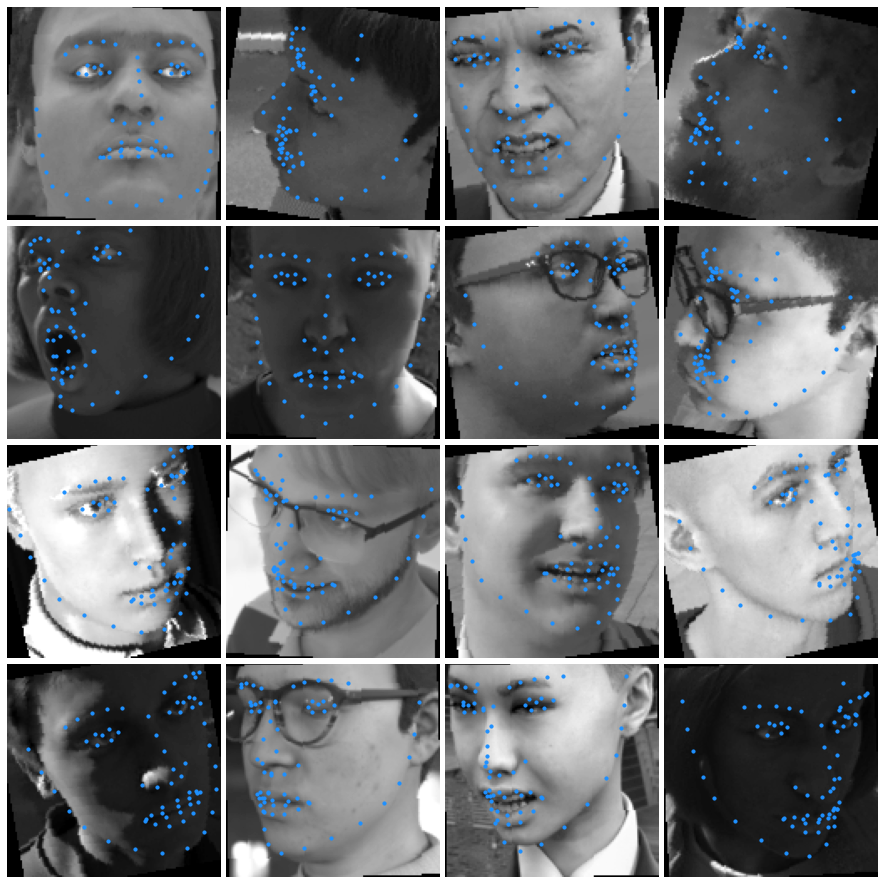

Epoch(15/30) -> Training Loss: 0.00089939 | Validation Loss: 0.00005193


Epoch(16/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


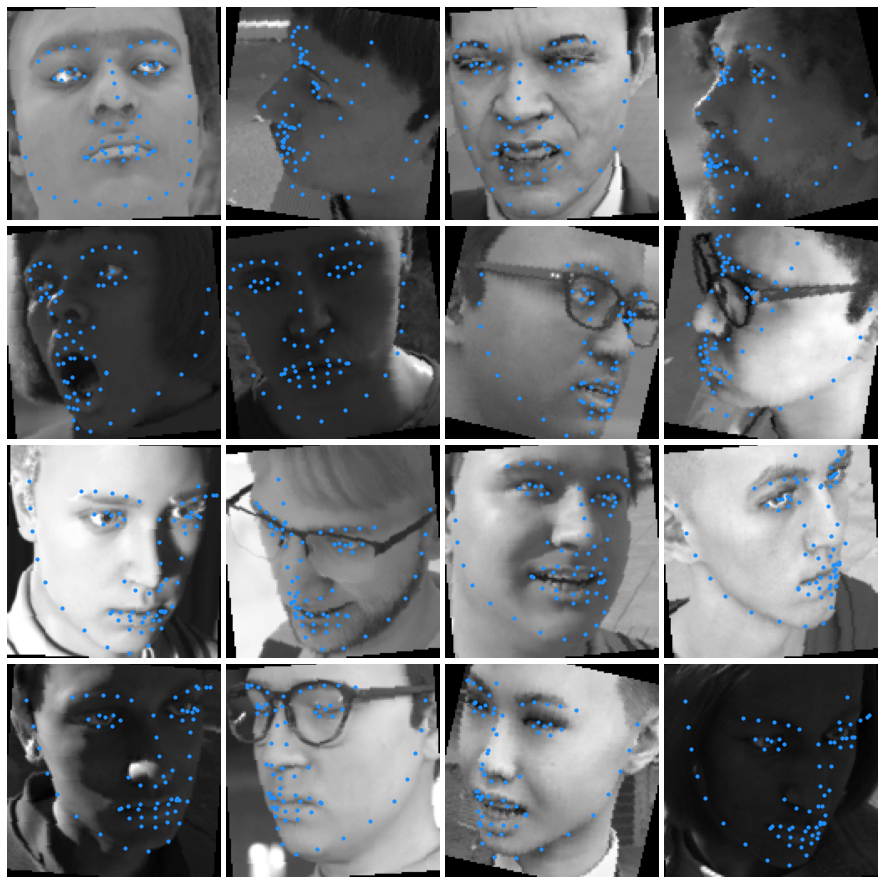

Saving model....................
Epoch(16/30) -> Training Loss: 0.00077177 | Validation Loss: 0.00004420


Epoch(17/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


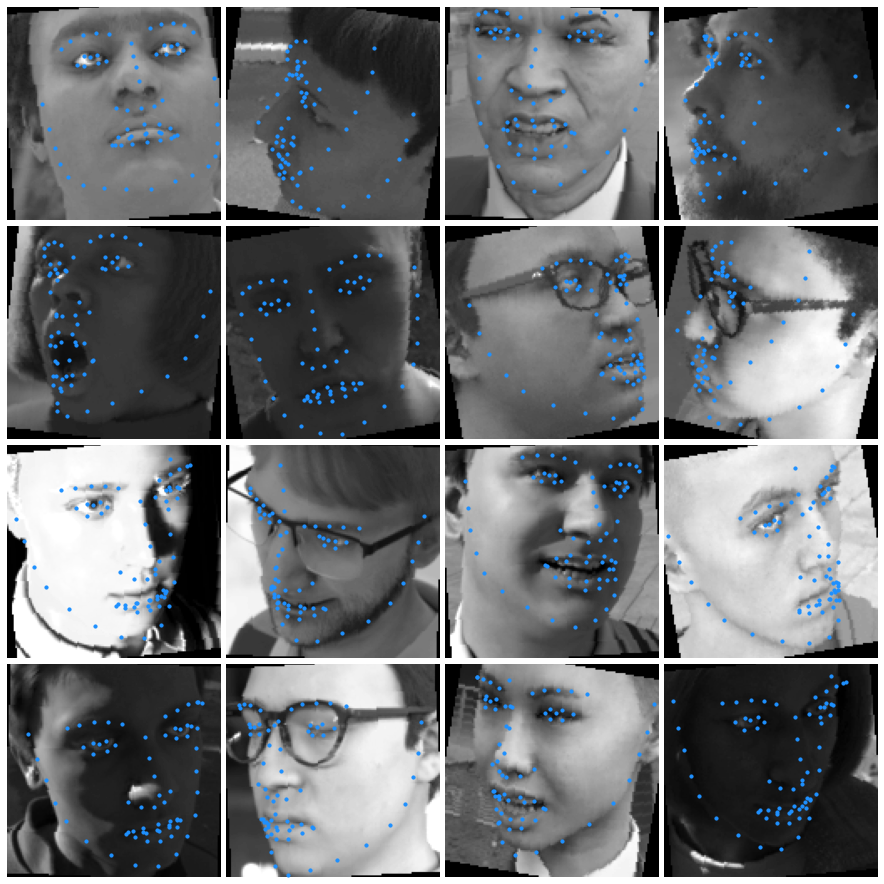

Saving model....................
Epoch(17/30) -> Training Loss: 0.00076241 | Validation Loss: 0.00003724


Epoch(18/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


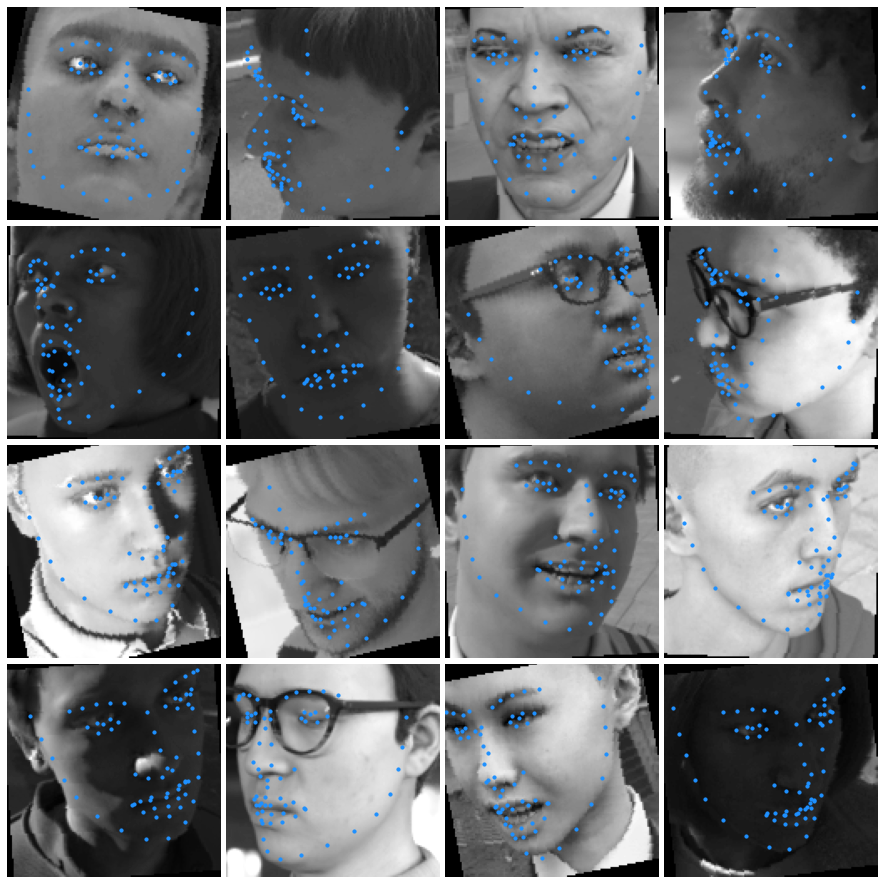

Epoch(18/30) -> Training Loss: 0.00071548 | Validation Loss: 0.00004517


Epoch(19/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


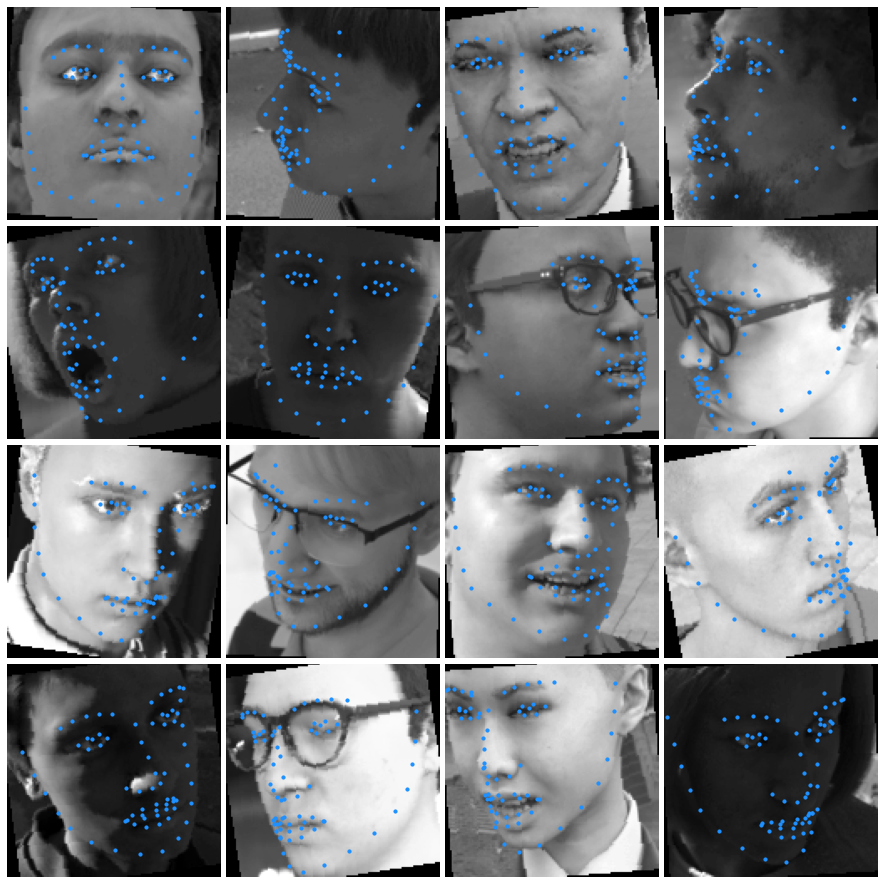

Epoch(19/30) -> Training Loss: 0.00087687 | Validation Loss: 0.00003889


Epoch(20/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


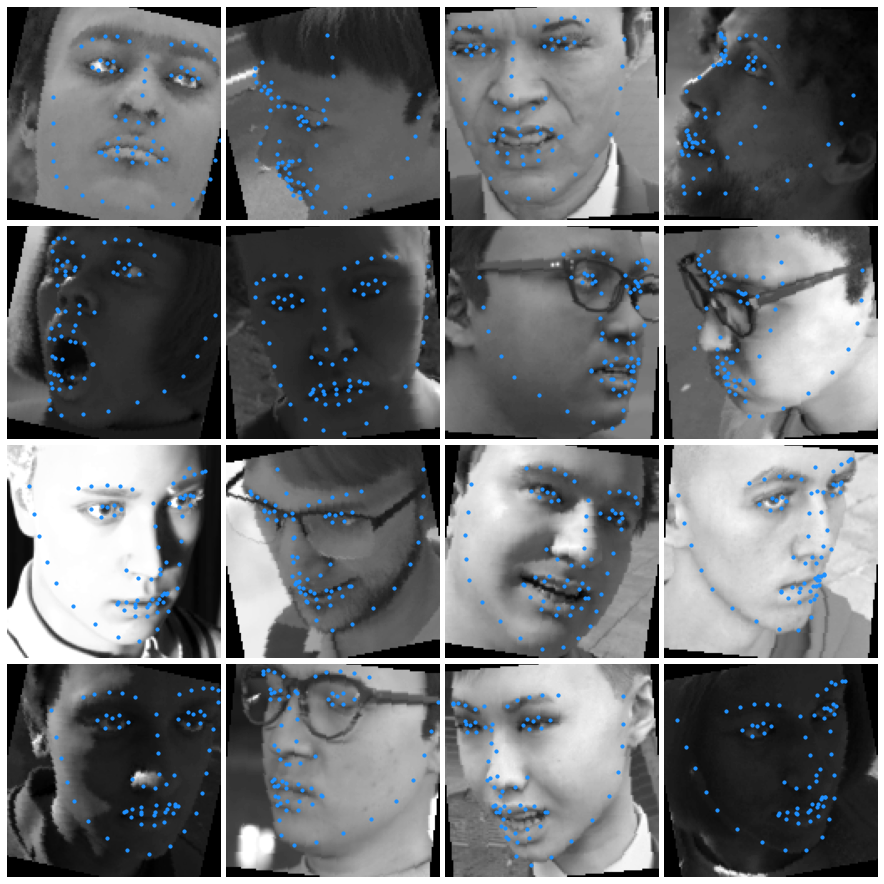

Epoch(20/30) -> Training Loss: 0.00074889 | Validation Loss: 0.00004272


Epoch(21/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


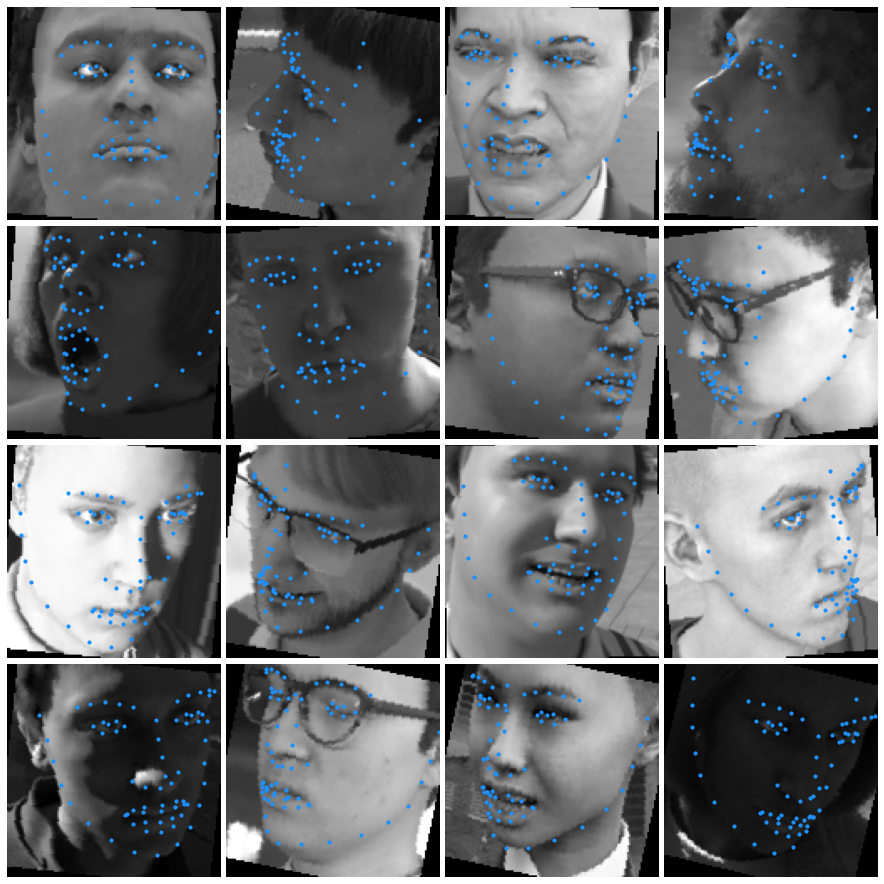

Saving model....................
Epoch(21/30) -> Training Loss: 0.00073776 | Validation Loss: 0.00003492


Epoch(22/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


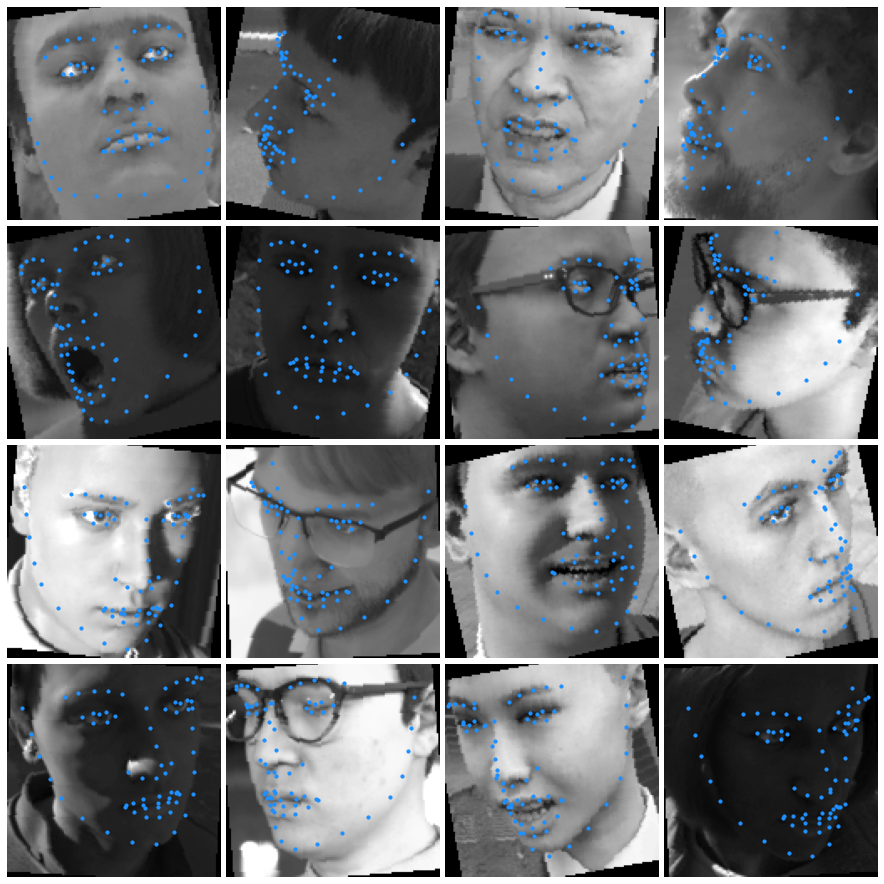

Epoch(22/30) -> Training Loss: 0.00073254 | Validation Loss: 0.00004249


Epoch(23/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


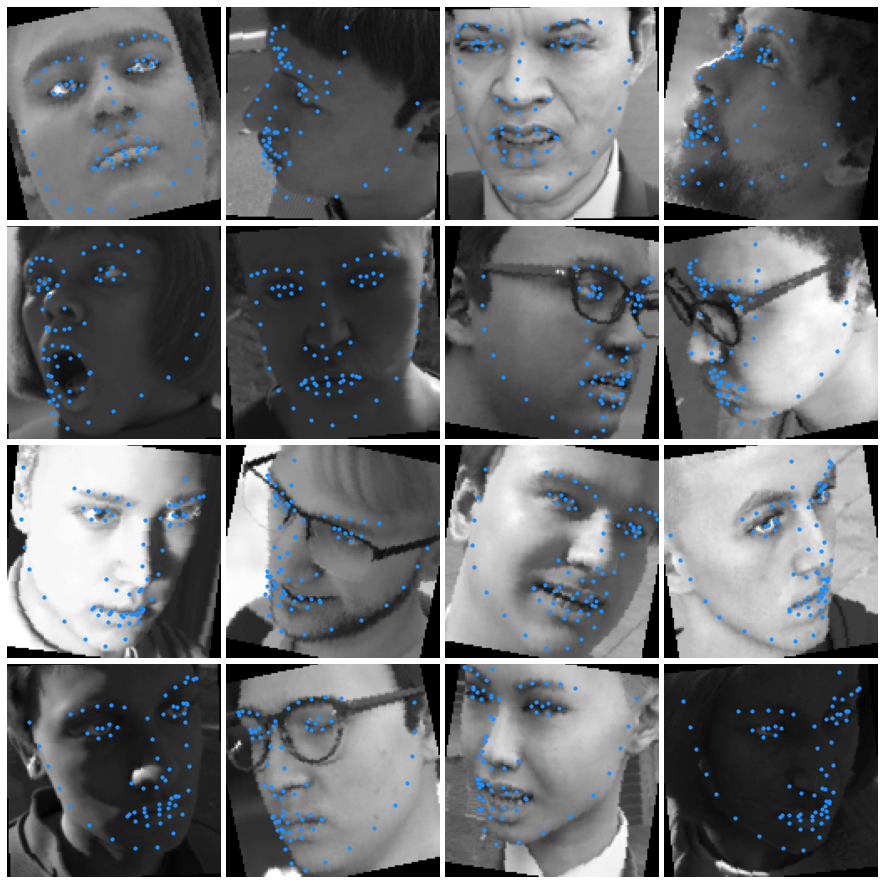

Epoch(23/30) -> Training Loss: 0.00064071 | Validation Loss: 0.00004068


Epoch(24/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


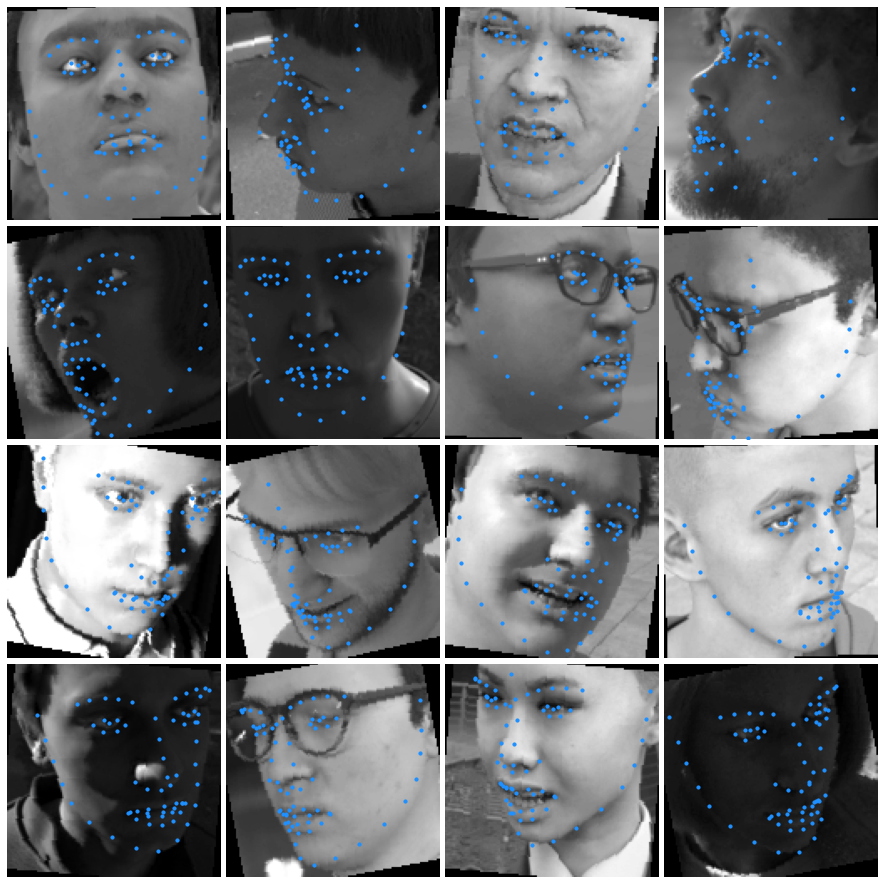

Saving model....................
Epoch(24/30) -> Training Loss: 0.00057328 | Validation Loss: 0.00003246


Epoch(25/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


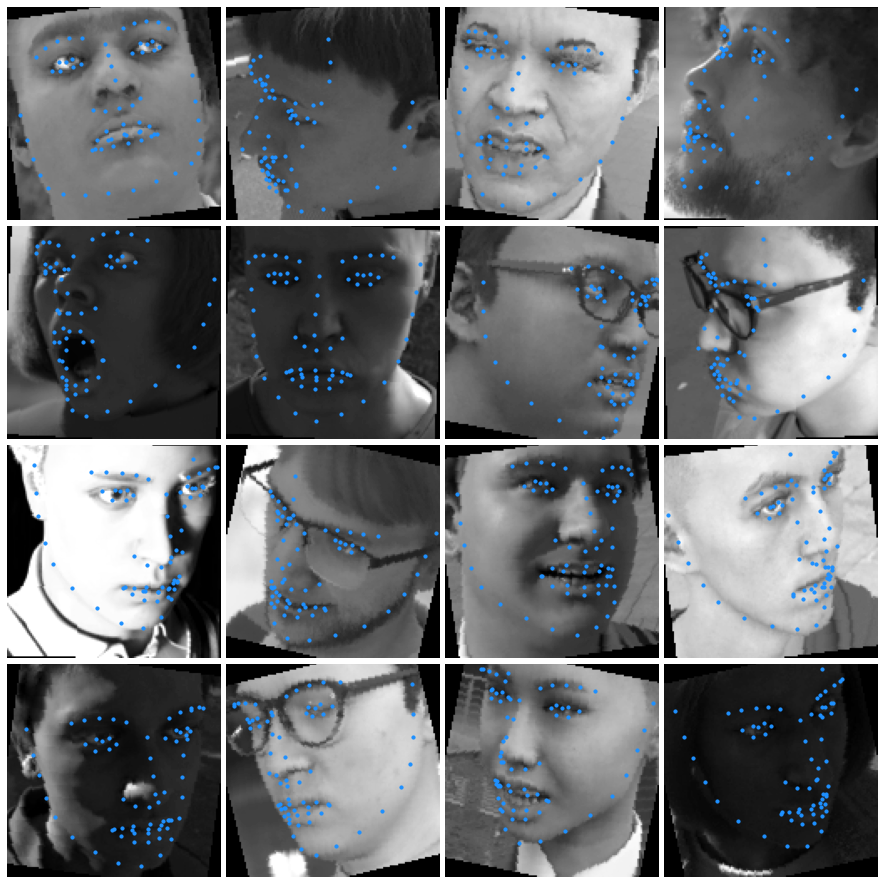

Saving model....................
Epoch(25/30) -> Training Loss: 0.00056450 | Validation Loss: 0.00002655


Epoch(26/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


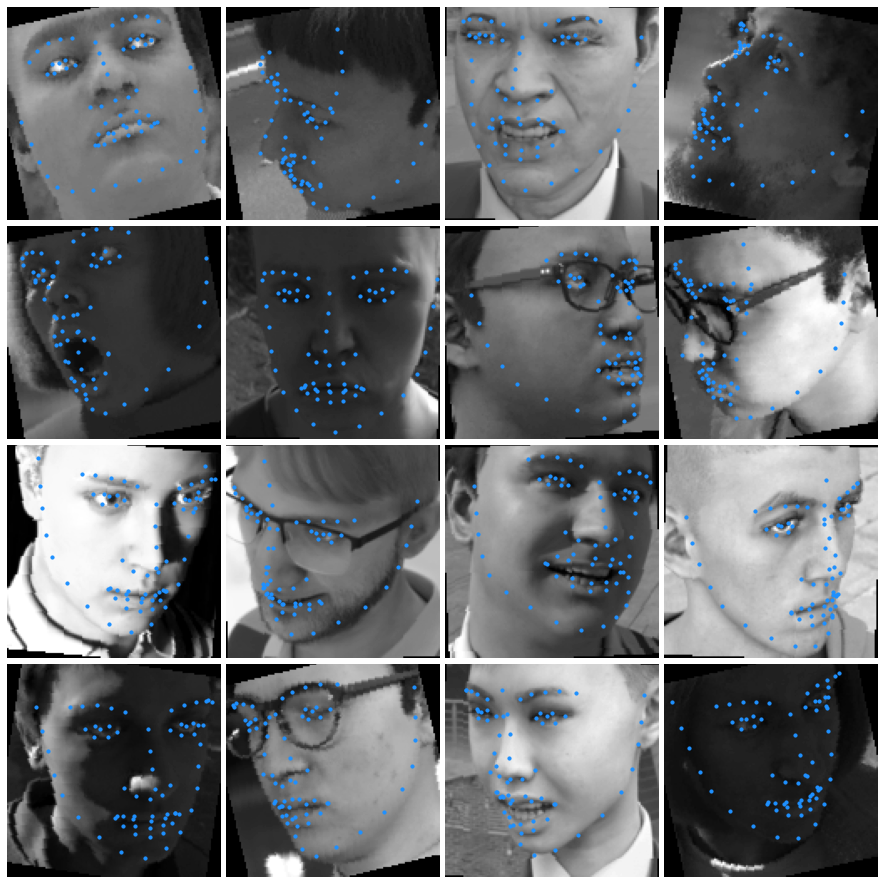

Epoch(26/30) -> Training Loss: 0.00052310 | Validation Loss: 0.00002831


Epoch(27/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


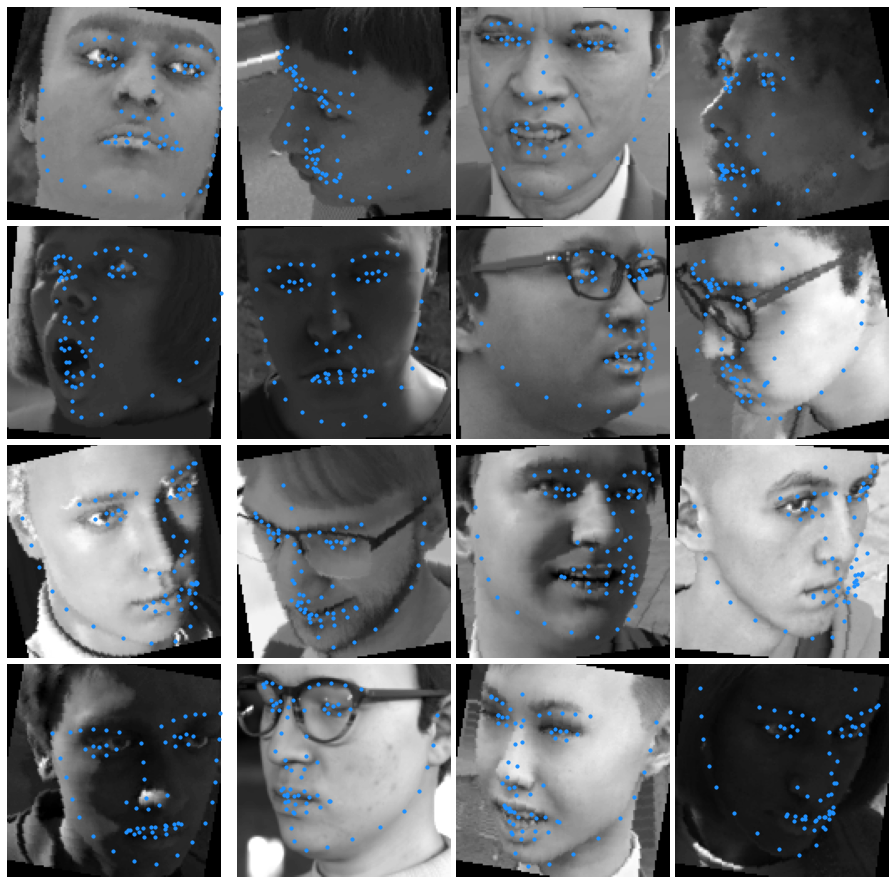

Epoch(27/30) -> Training Loss: 0.00066418 | Validation Loss: 0.00008938


Epoch(28/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


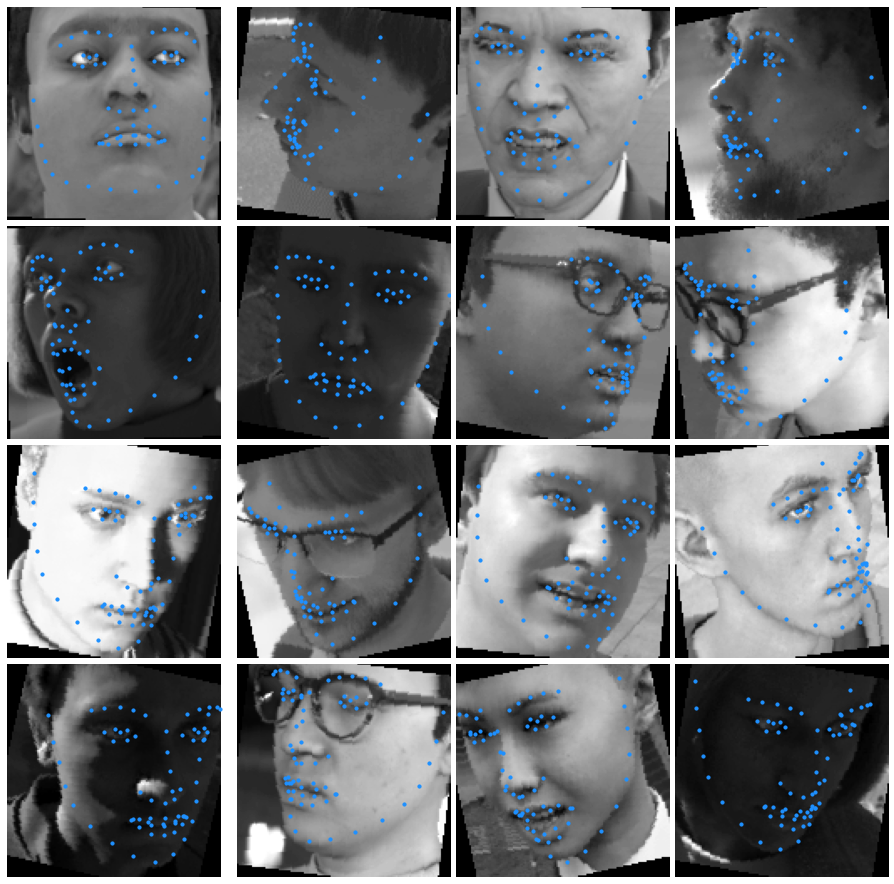

Epoch(28/30) -> Training Loss: 0.00072284 | Validation Loss: 0.00003383


Epoch(29/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


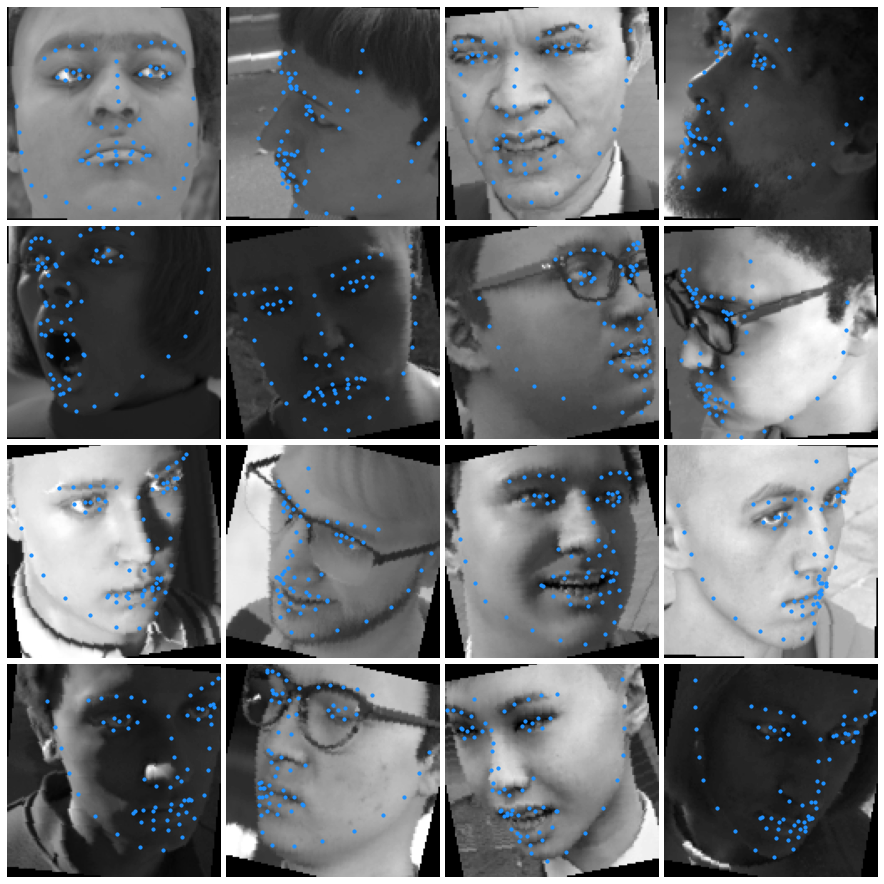

Epoch(29/30) -> Training Loss: 0.00052525 | Validation Loss: 0.00003040


Epoch(30/30):   0%|                                                                                           …

Validating:   0%|                                                                                             …

Validation sample predictions


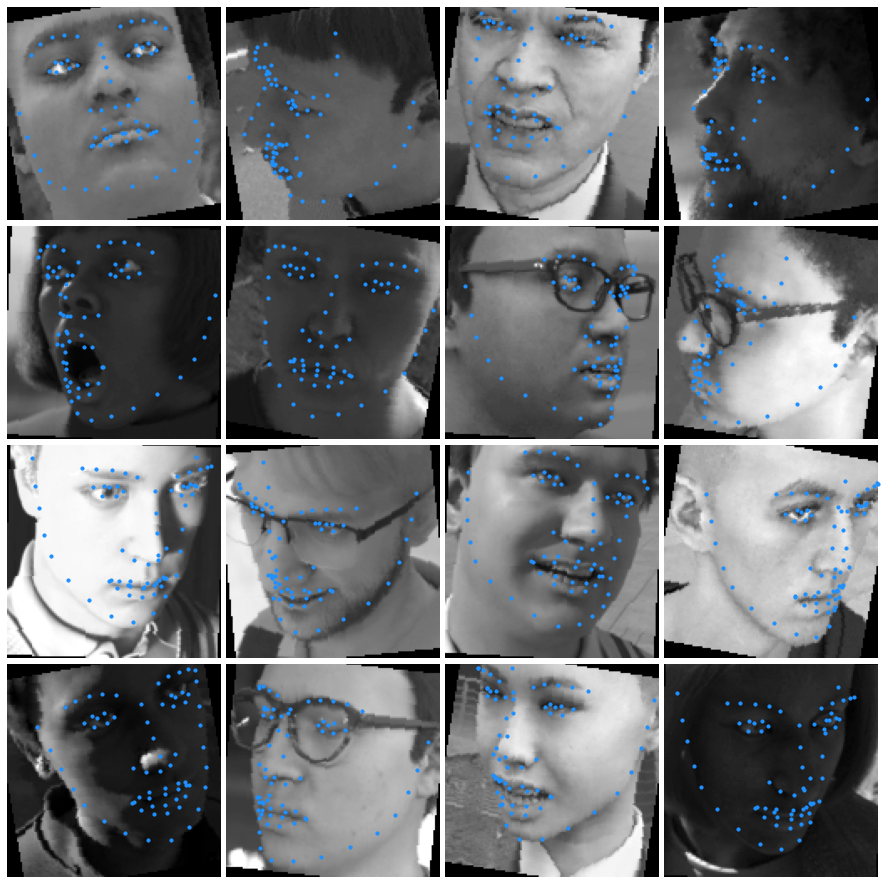

Epoch(30/30) -> Training Loss: 0.00048185 | Validation Loss: 0.00002775


In [ ]:
epochs = 30
batches = len(train_data)
best_loss = np.inf
optimizer.zero_grad()

for epoch in range(epochs):
    cum_loss = 0.0

    model.train()
    for batch_index, (features, labels) in enumerate(tqdm(train_data, desc = f'Epoch({epoch + 1}/{epochs})', ncols = 800)):
        features = features.cuda()
        labels = labels.cuda()

        outputs = model(features)
        
        loss = objective(outputs, labels)

        loss.backward()

        optimizer.step()
        
        optimizer.zero_grad()

        cum_loss += loss.item()

    val_loss = validate(os.path.join('progress', f'epoch({str(epoch + 1).zfill(len(str(epochs)))}).jpg'))

    if val_loss < best_loss:
        best_loss = val_loss
        print('Saving model....................')
        torch.save(model.state_dict(), 'model.pt')

    print(f'Epoch({epoch + 1}/{epochs}) -> Training Loss: {cum_loss/batches:.8f} | Validation Loss: {val_loss:.8f}')

# __Inference__

In [ ]:
model.load_state_dict(torch.load('model.pt', map_location = 'cpu'))

<All keys matched successfully>

In [ ]:
import dlib
from imutils import face_utils, resize

In [ ]:
! unzip /content/drive/MyDrive/CMPT732/project/21000.zip

Archive:  /content/drive/MyDrive/CMPT732/project/21000.zip
  inflating: 21000/21989.png         
  inflating: 21000/21980.png         
  inflating: 21000/21983.png         
  inflating: 21000/21985.png         
  inflating: 21000/21977.png         
  inflating: 21000/21994.png         
  inflating: 21000/21978.png         
  inflating: 21000/21971.png         
  inflating: 21000/21968.png         
  inflating: 21000/21995.png         
  inflating: 21000/21982.png         
  inflating: 21000/21997.png         
  inflating: 21000/21974.png         
  inflating: 21000/21991.png         
  inflating: 21000/21976.png         
  inflating: 21000/21967.png         
  inflating: 21000/21992.png         
  inflating: 21000/21996.png         
  inflating: 21000/21972.png         
  inflating: 21000/21966.png         
  inflating: 21000/21988.png         
  inflating: 21000/21970.png         
  inflating: 21000/21998.png         
  inflating: 21000/21987.png         
  inflating: 21000/21984.png 

In [ ]:
def preprocess_image(image):
    image = TF.to_pil_image(image)
    image = TF.resize(image, (128, 128))
    image = TF.to_tensor(image)
    image = (image - image.min())/(image.max() - image.min())
    image = (2 * image) - 1
    return image.unsqueeze(0)

def draw_landmarks_on_faces(image, faces_landmarks):
    image = image.copy()
    for landmarks, (left, top, height, width) in faces_landmarks:
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5)
        landmarks = landmarks.numpy()
        
        for i, (x, y) in enumerate(landmarks, 1):
            try:
                cv2.circle(image, (int((x * width) + left), int((y * height) + top)), 2, [40, 117, 255], -1)
            except:
                pass
    
    return image

In [ ]:
face_detector = dlib.get_frontal_face_detector()

@torch.no_grad()
def inference(img_path):
    img = cv2.imread(os.path.join('/content/21000', img_path))
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    faces = face_detector(gray, 1)

    outputs = []

    for (i, face) in enumerate(faces):
        (x, y, w, h) = face_utils.rect_to_bb(face)

        crop_img = gray[y: y + h, x: x + w]
        preprocessed_image = preprocess_image(crop_img)
        landmarks_predictions = model(preprocessed_image.cuda())
        outputs.append((landmarks_predictions.cpu(), (x, y, h, w)))

    return draw_landmarks_on_faces(img, outputs)

In [ ]:
img_paths = sorted(os.listdir('/content/21000'))

In [ ]:
outputs = []

for img_path in img_paths:    
        output = inference(img_path)
        outputs.append(output)

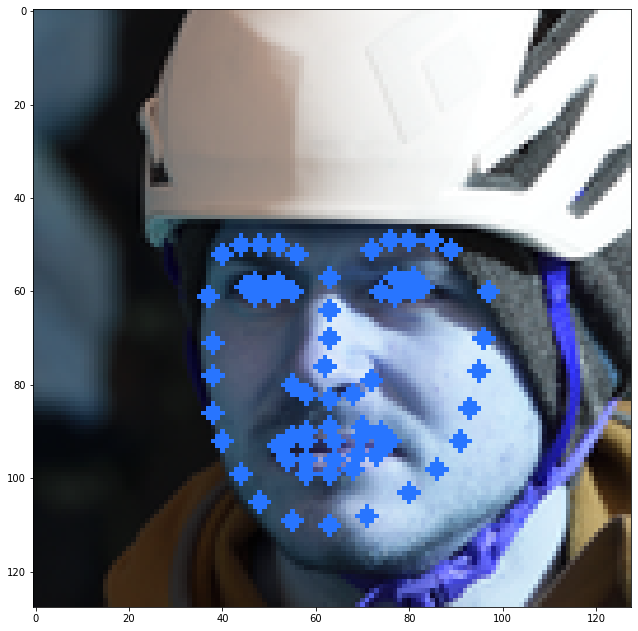

In [ ]:
plt.figure(figsize = (10, 10))
plt.imshow(outputs[10]) 

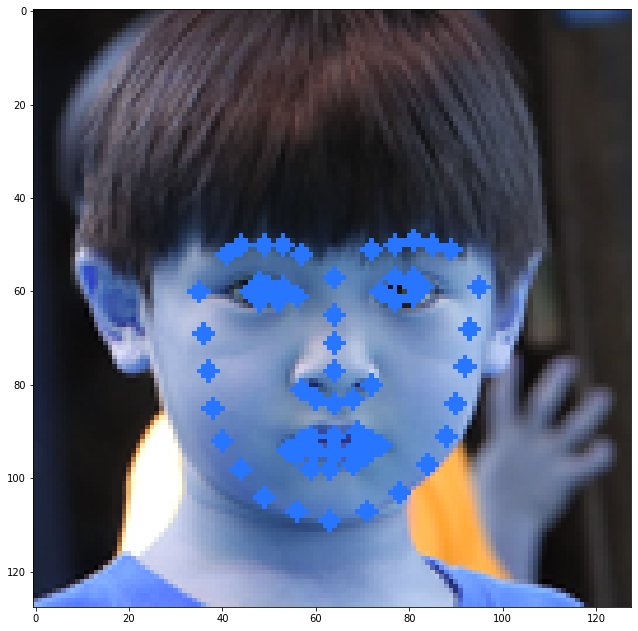

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[20]) 

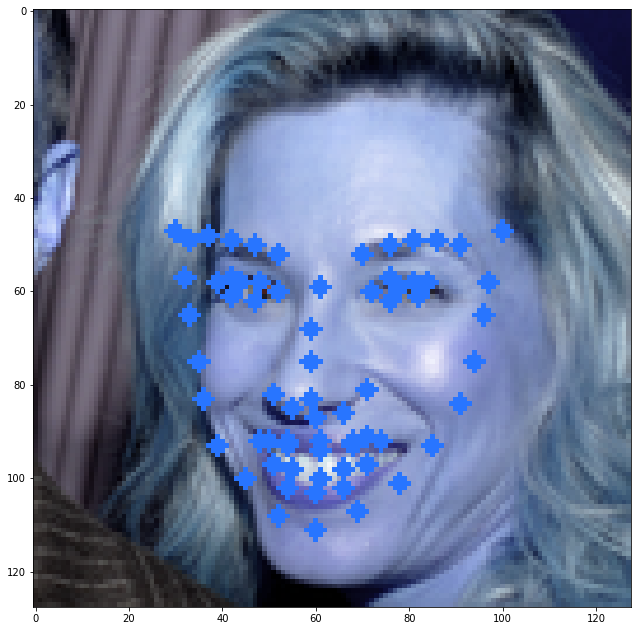

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[30]) 

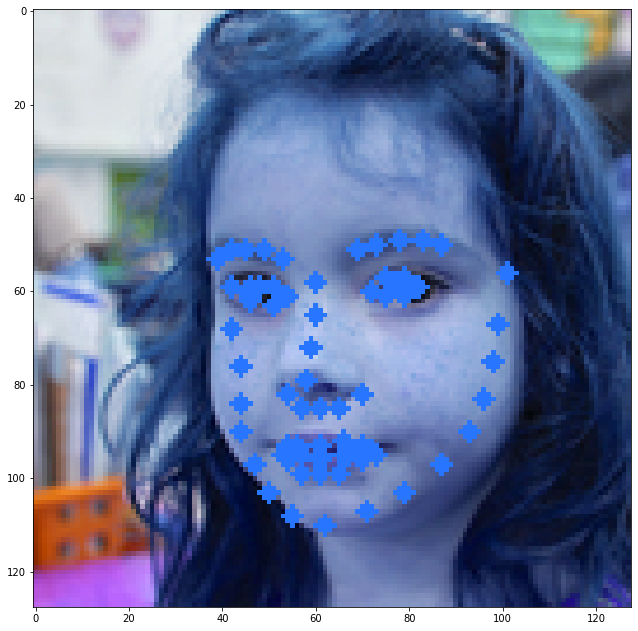

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[40]) 

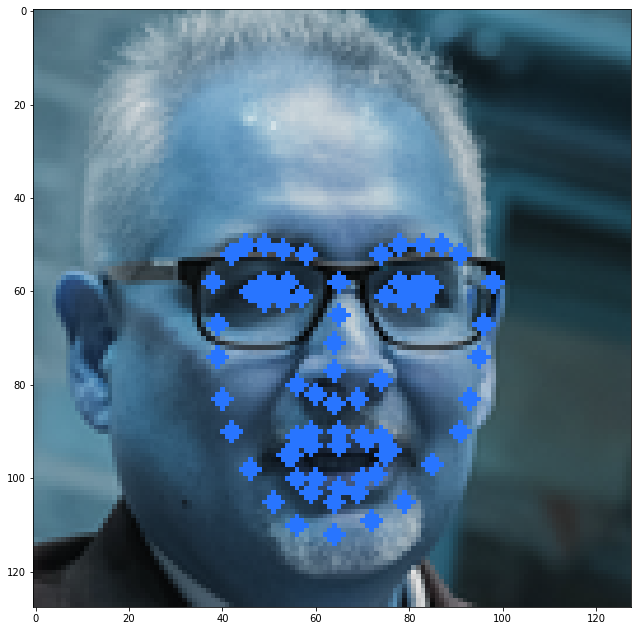

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[50]) 

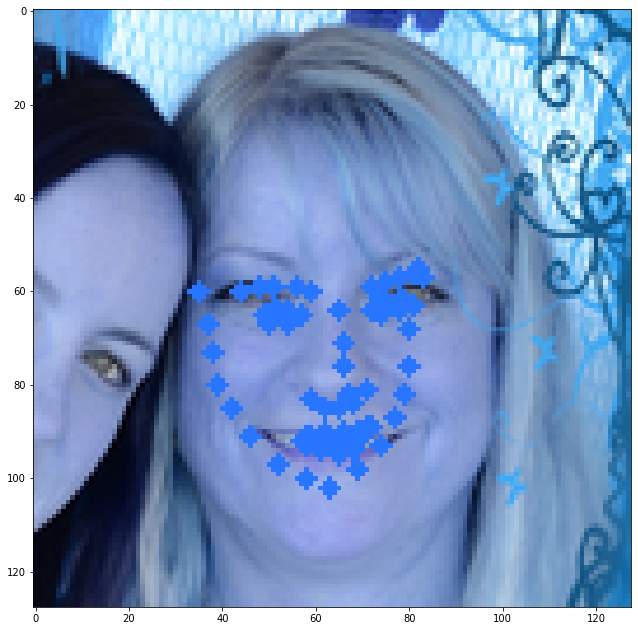

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[60]) 

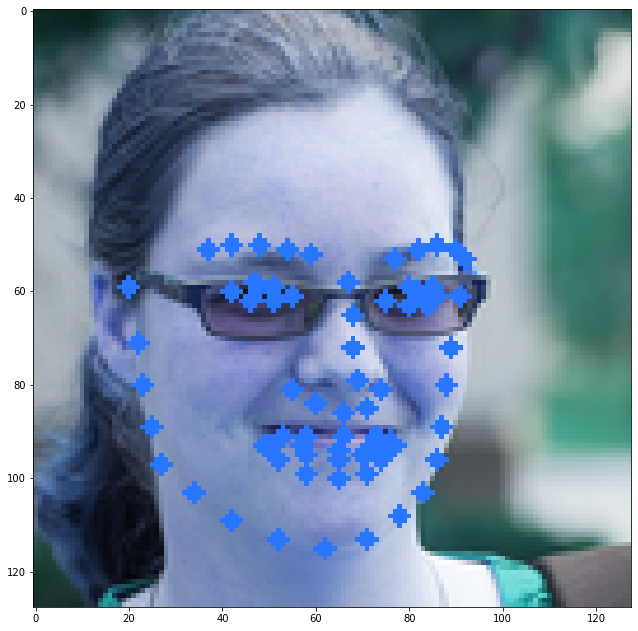

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[70]) 

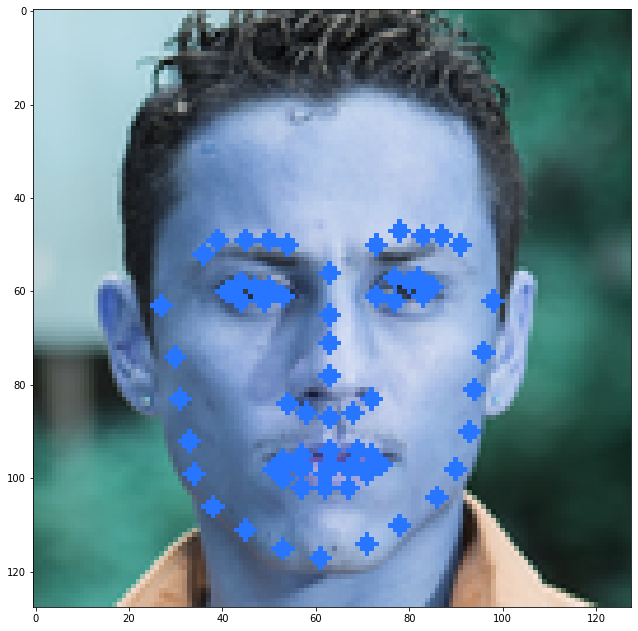

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[80]) 

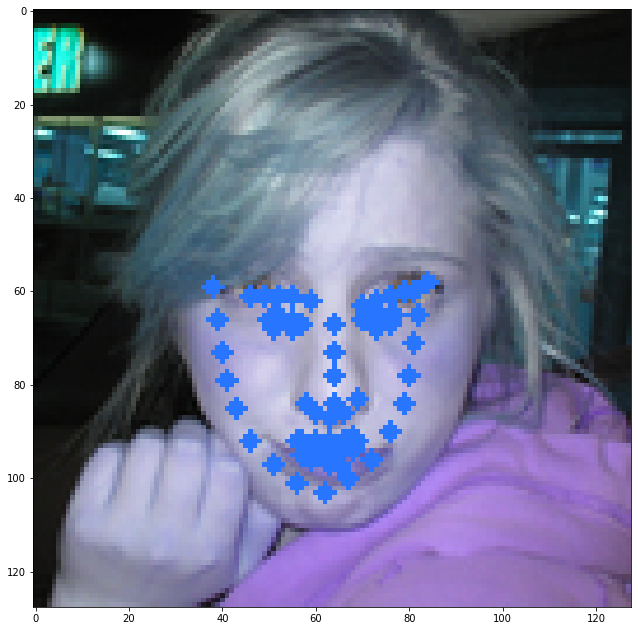

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[90]) 

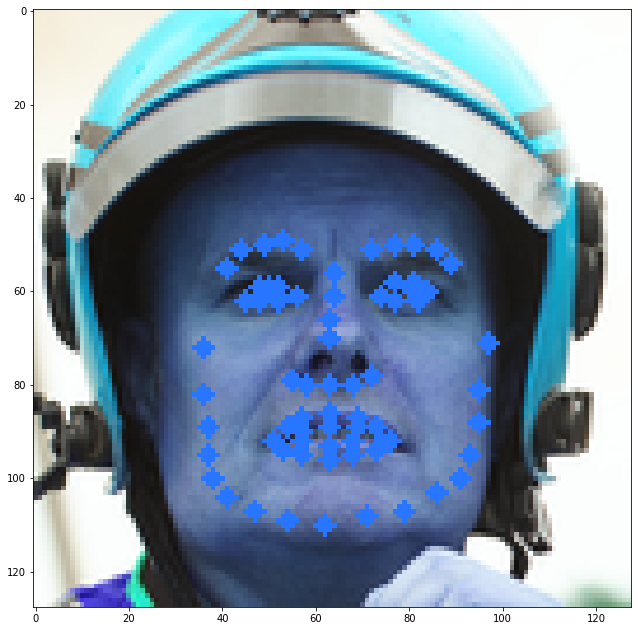

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[100]) 

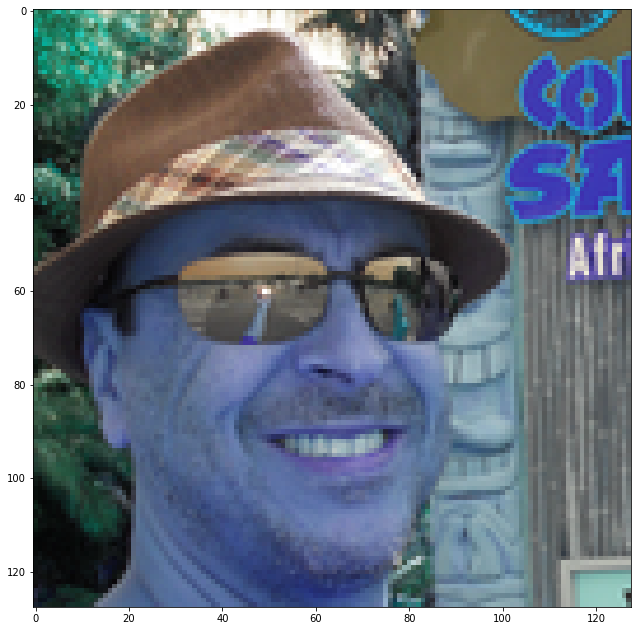

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[110]) 

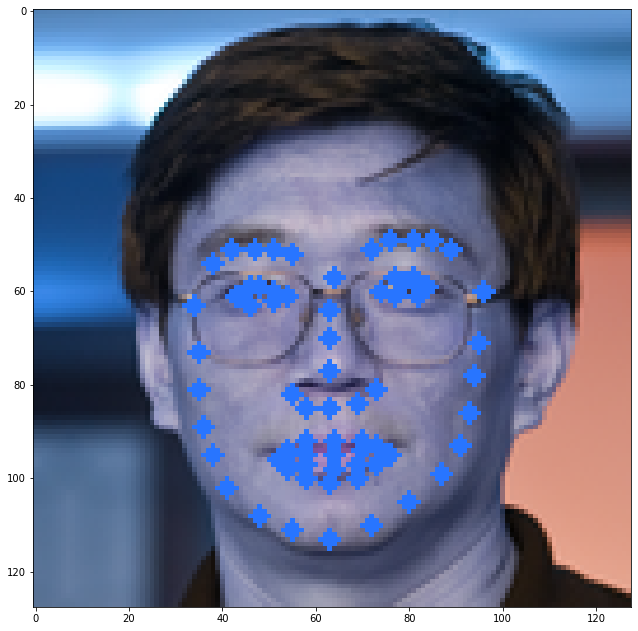

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[120]) 

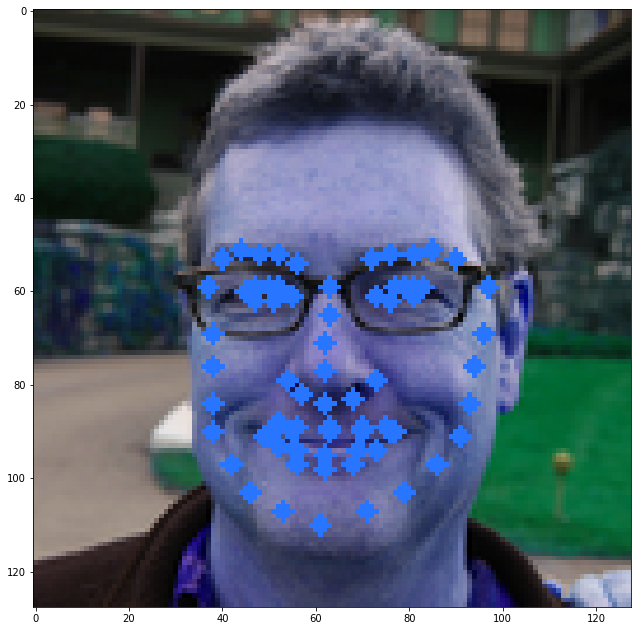

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[130]) 

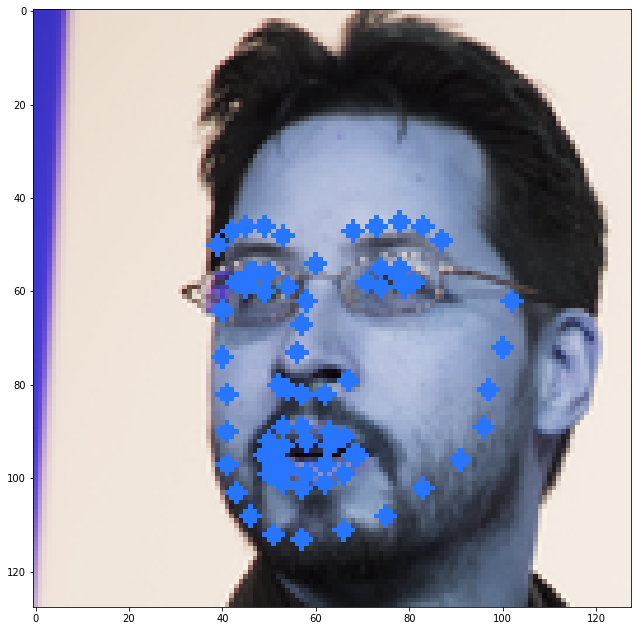

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[140]) 

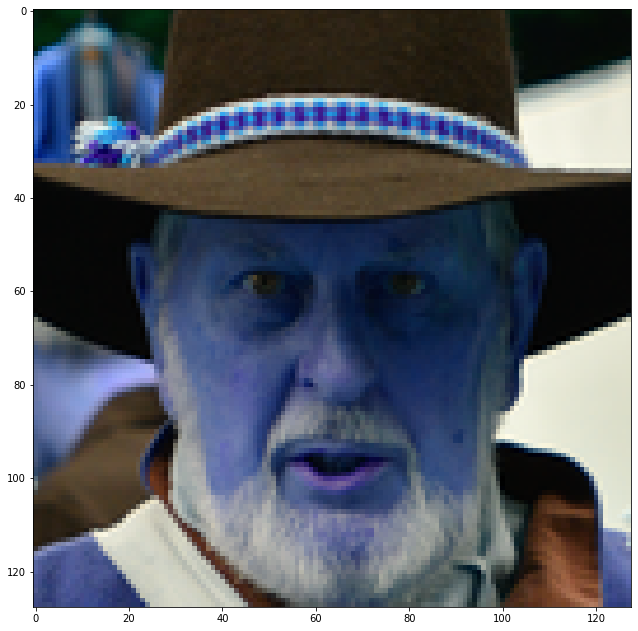

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[150]) 

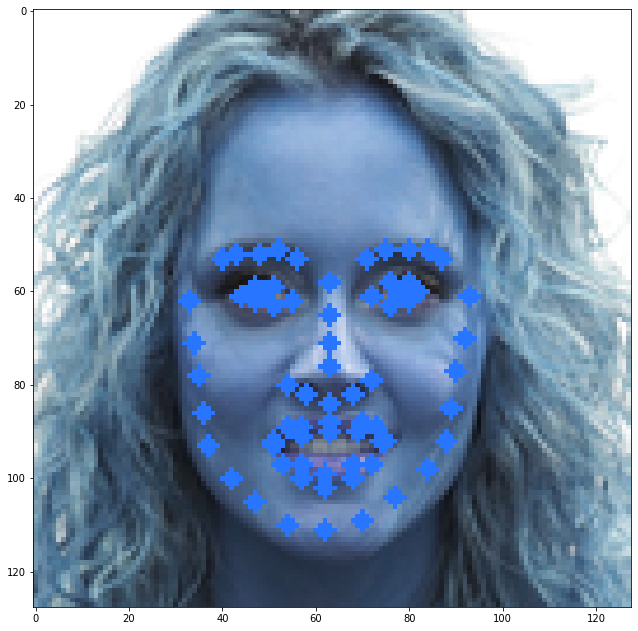

In [ ]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[160]) 

# Inference-video

In [ ]:
!pip install youtube-dl
!pip install moviepy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 6.5 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import dlib
import youtube_dl
from imutils import face_utils, resize
!pip install moviepy==1.0.3

from moviepy.editor import VideoFileClip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 388 kB 6.6 MB/s 
     |████████████████████████████████| 26.9 MB 1.2 MB/s 
  Created wheel for moviepy: filename=moviepy-1.0.3-py3-none-any.whl size=110743 sha256=84da68d658617657da3887a10b5ec4b1885f4d6517be76dda6e1ff6eb3d40ec8
  Stored in directory: /root/.cache/pip/wheels/56/dc/2b/9cd600d483c04af3353d66623056fc03faed76b7518faae4df
Successfully built moviepy
  Attempting uninstall: moviepy
    Found existing installation: moviepy 0.2.3.5
    Uninstalling moviepy-0.2.3.5:
      Successfully uninstalled moviepy-0.2.3.5


In [ ]:
def preprocess_image(image):
    image = TF.to_pil_image(image)
    image = TF.resize(image, (128, 128))
    image = TF.to_tensor(image)
    image = (image - image.min())/(image.max() - image.min())
    image = (2 * image) - 1
    return image.unsqueeze(0)

def draw_landmarks_on_faces(image, faces_landmarks):
    image = image.copy()
    for landmarks, (left, top, height, width) in faces_landmarks:
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5)
        landmarks = landmarks.numpy()
        
        for i, (x, y) in enumerate(landmarks, 1):
            try:
                cv2.circle(image, (int((x * width) + left), int((y * height) + top)), 2, [40, 117, 255], -1)
            except:
                pass
    
    return image

In [ ]:
face_detector = dlib.get_frontal_face_detector()

@torch.no_grad()
def inference(frame):
    gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
    faces = face_detector(gray, 1)

    outputs = []

    for (i, face) in enumerate(faces):
        (x, y, w, h) = face_utils.rect_to_bb(face)

        crop_img = gray[y: y + h, x: x + w]
        preprocessed_image = preprocess_image(crop_img)
        landmarks_predictions = model(preprocessed_image.cuda())
        outputs.append((landmarks_predictions.cpu(), (x, y, h, w)))

    return draw_landmarks_on_faces(frame, outputs)

In [ ]:
def output_video(video, name, seconds = None):
    total = int(video.fps * seconds) if seconds else int(video.fps * video.duration)
    print('Will read', total, 'images...')
    
    outputs = []

    writer = cv2.VideoWriter(name + '.mp4', cv2.VideoWriter_fourcc(*'mp4v'), video.fps, tuple(video.size))

    for i, frame in enumerate(tqdm(video.iter_frames(), total = total), 1):    
        if seconds:
            if (i + 1) == total:
                break
                
        output = inference(frame)
        outputs.append(output)

        writer.write(cv2.cvtColor(output, cv2.COLOR_RGB2BGR))

    writer.release()

    return outputs

In [ ]:
ydl_opts = {}
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download(['https://www.youtube.com/watch?v=kib6uXQsxBA'])

[youtube] kib6uXQsxBA: Downloading webpage
[download] Destination: Steve Jobs on Quality-kib6uXQsxBA.f134.mp4
[download] 100% of 3.03MiB in 00:45
[download] Destination: Steve Jobs on Quality-kib6uXQsxBA.f140.m4a
[download] 100% of 2.92MiB in 00:43
[ffmpeg] Merging formats into "Steve Jobs on Quality-kib6uXQsxBA.mp4"
Deleting original file Steve Jobs on Quality-kib6uXQsxBA.f134.mp4 (pass -k to keep)
Deleting original file Steve Jobs on Quality-kib6uXQsxBA.f140.m4a (pass -k to keep)


In [ ]:
video = VideoFileClip("/content/Steve Jobs on Quality-kib6uXQsxBA.mp4")
print('FPS:', video.fps)
print('Duration:', video.duration, 'seconds')

FPS: 10.0
Duration: 189.06 seconds


(360, 576, 3)


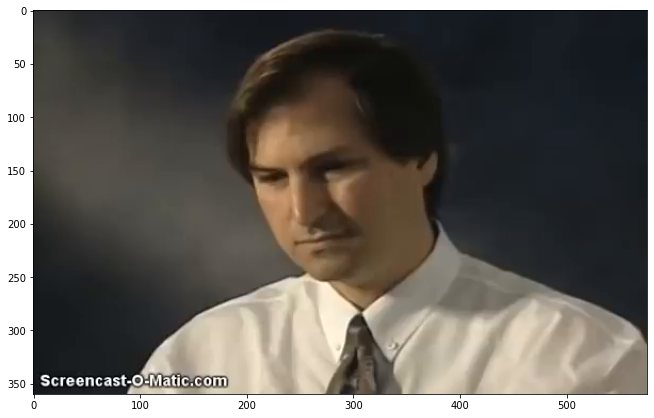

In [ ]:
for frame in video.iter_frames():
    break

print(frame.shape)
plt.figure(figsize = (11, 11))
plt.imshow(frame)

In [ ]:
outputs = output_video(video, 'jobs_output')

Will read 1890 images...


  0%|          | 0/1890 [00:00<?, ?it/s]

  UserWarning)



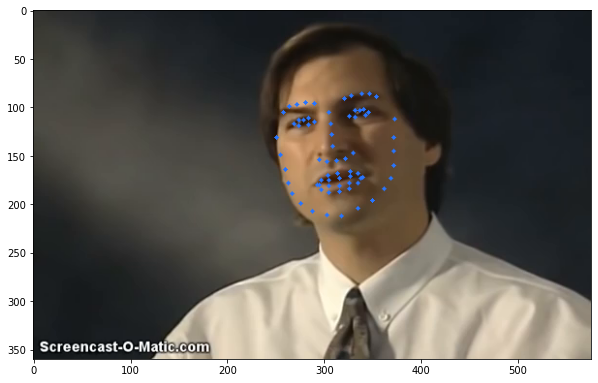

In [ ]:
plt.figure(figsize = (10, 10))
plt.imshow(outputs[300])